### Background and history
*COMING SOON*

### Justification
*COMING SOON*

### Prerequisites for reading
*COMING SOON*

### Objectives
*COMING SOON*

### Workflow

*COMING SOON*

### Import all necessary packages

In [1]:
import numpy as np
import scipy as sp
from scipy import ndimage as ndi
from scipy import signal
from numpy.fft import fft2, ifft2, fftshift, ifftshift
from kneed import KneeLocator
from skimage import io
from skimage.util import img_as_float
from skimage.filters import gaussian
from skimage.color import rgb2gray, label2rgb
from skimage.feature import peak_local_max, canny
from skimage.restoration import denoise_tv_chambolle
from skimage.draw import  circle, circle_perimeter
import skimage.morphology as morph
from skimage.measure import label, compare_ssim
import skimage.exposure as skie
import matplotlib.pyplot as plt
import matplotlib.colors as clr
from skimage.draw import ellipse
from skimage.transform import rotate

### Load some test data: import King Tut CT scan image

Source: Supreme Council of Antiquities,  guardians.net/hawass/press_release_tutankhamun_ct_scan_results.htm

##### Function to normalize arrays to [0 1] range

In [2]:
def normalise(arr):
    return (arr-np.amin(arr))/(np.amax(arr)-np.amin(arr))

In [3]:
data = normalise(rgb2gray(io.imread('tut.jpg')))
print(np.shape(data), np.amin(data), np.amax(data))

(400, 400) 0.0 1.0


##### Add some blur

In [4]:
data=gaussian(data, 1)

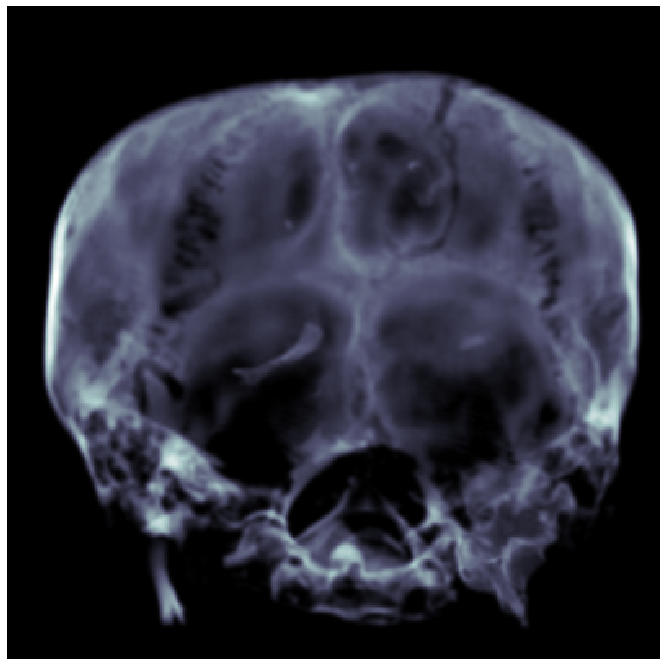

In [5]:
plt.figure(figsize=(15,12))
plt.imshow(data, cmap='bone'), plt.axis('off'); 

##### All-in-one function to perform Fourier transform, get magnitude, center on low frequency (for display purposes)

In [6]:
def numpy_fft2(im):
    F = np.fft.fft2(im)     # Perform 2-dimensional discrete Fourier transform 
    C = np.fft.fftshift(F)  # Center spectrum on minimum frequency
    Mag = np.abs(C).real    # Get magnitude and phase
    Ph  = np.angle(C).real    
    return Mag, Ph

In [7]:
A, _ = numpy_fft2(data)

In [8]:
Ag = denoise_tv_chambolle(np.log(A +1), weight=0.2)  
lg = np.log(A +1)

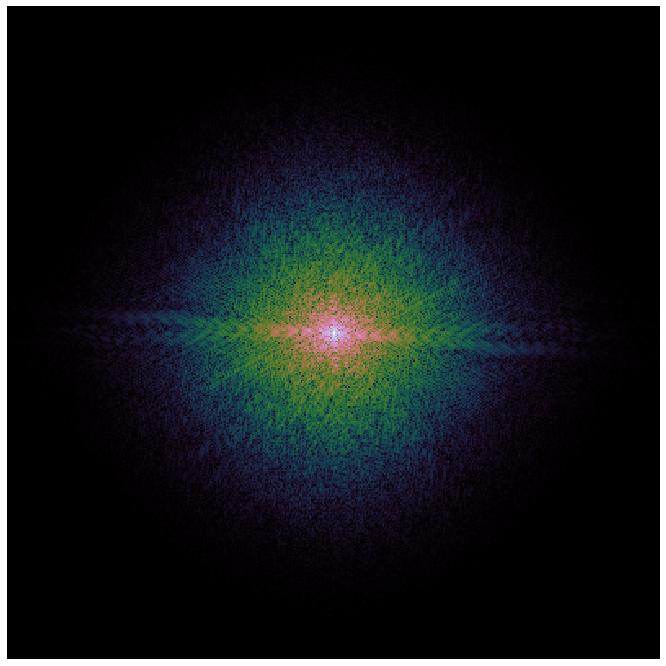

In [9]:
plt.figure(figsize=(12, 12))
plt.imshow(lg,  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

#### Get azimuthally averaged radial profile

To show that the data "lives" in the lowest frequencies.

Radial mean code adapted from [SciPy lectures](http://scipy-lectures.org/advanced/image_processing/#measuring-objects-properties-ndimage-measurements) (his method, compared to other ones tested, works better in that I can set the number of bins to be same as the size of the input image).

Automatic knee-point detection with the [Kneedle algorithm](https://raghavan.usc.edu//papers/kneedle-simplex11.pdf) using the [Kneed package](https://github.com/arvkevi/kneed).

In [10]:
sx, sy = Ag.shape
X, Y = np.ogrid[0:sx, 0:sy]
r = np.hypot(X - sx/2, Y - sy/2)
rbin = (502* r/r.max()).astype(np.int)
with np.errstate(invalid='ignore'):
    radial_mean = ndi.mean(Ag**2, labels=rbin, index=np.arange(1, rbin.max() +1))
radial_mean = radial_mean[~np.isnan(radial_mean)]

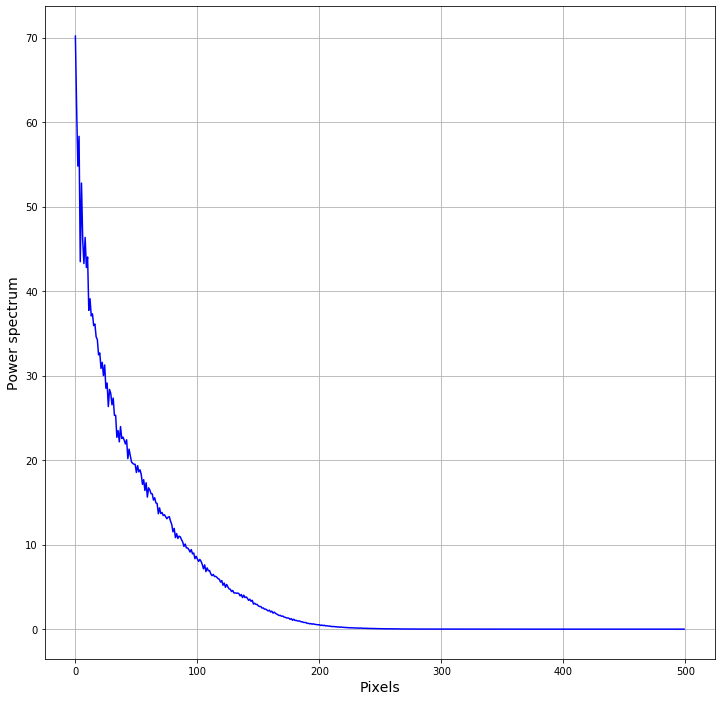

In [11]:
fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(radial_mean, 'b')
ax.set_xlabel('Pixels', fontsize=14)
ax.set_ylabel('Power spectrum', fontsize=14)
ax.grid(which='both')

In [12]:
kl = KneeLocator(np.arange(0,len(radial_mean)), radial_mean, curve='convex', direction='decreasing',  online=True)
print(kl.knee)

180


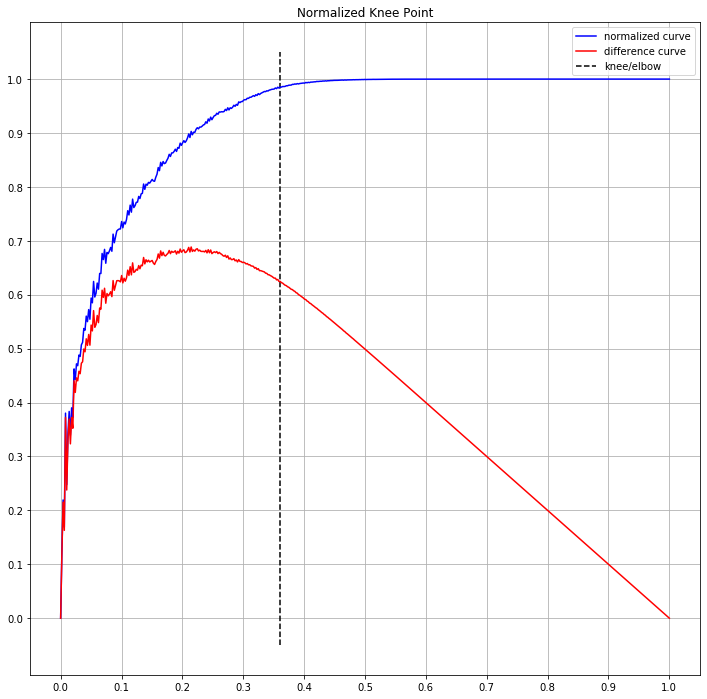

In [13]:
kl.plot_knee_normalized()
fig = plt.gcf()
fig.set_size_inches(12,12)
#plt.gca().invert_yaxis()
plt.grid(which='both')

In [14]:
radius = int(kl.knee/2)
rr, cc = circle_perimeter(np.shape(Ag)[0]//2, np.shape(Ag)[0]//2, radius)
lg[rr, cc] = np.amax(lg)

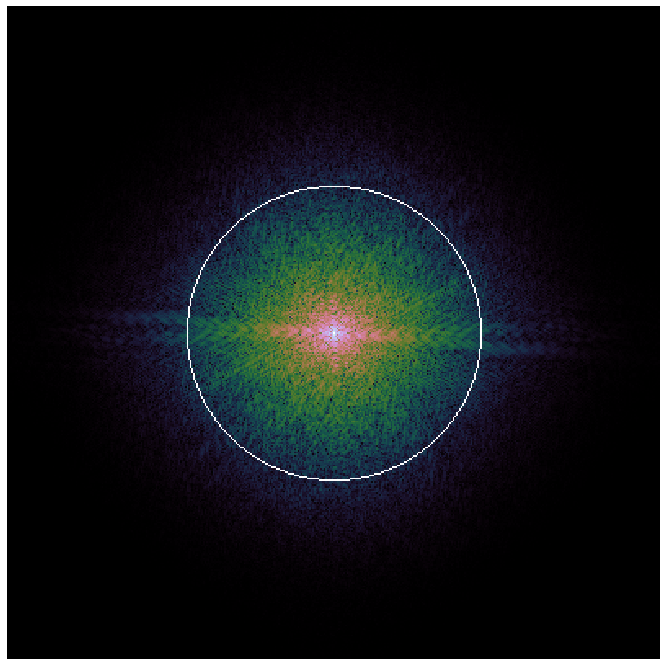

In [15]:
plt.figure(figsize=(12, 12))
plt.imshow(lg,  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

### Preliminary examples of 2D Fourier Transform of straight lines and sinusoids

##### How does the Fourier spectrum of a vertical line looks like?

Reference blog post from Steve Eddins (Mathworks): ["Fourier transforms, vertical lines, and horizontal lines"](https://blogs.mathworks.com/steve/2010/09/22/fourier-transforms-vertical-lines-and-horizontal-lines/)

Further reading: ["An Intuitive Explanation of Fourier Theory"](http://cns-alumni.bu.edu/~slehar/fourier/fourier.html)

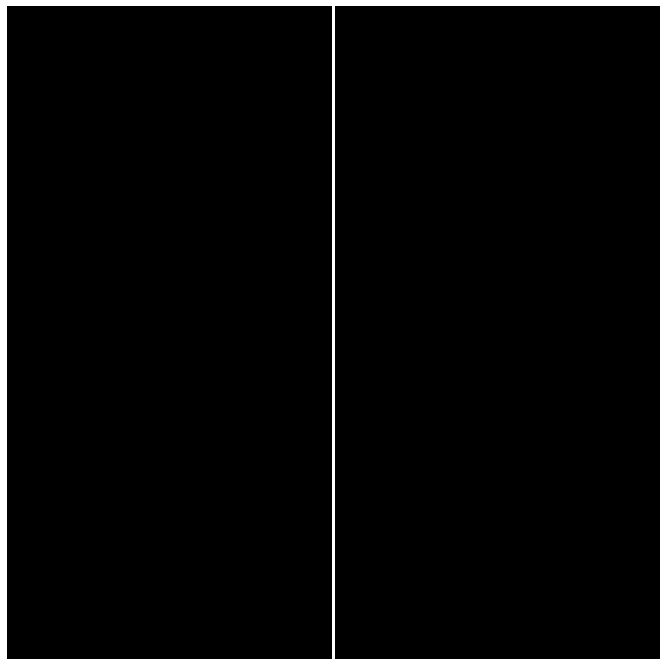

In [16]:
vline = np.zeros((201,201))
vline[:,100]=1
plt.figure(figsize=(12,12))
plt.imshow(vline, cmap='gray', interpolation = 'none'), plt.axis('off');

In [17]:
A, _ = numpy_fft2(vline)

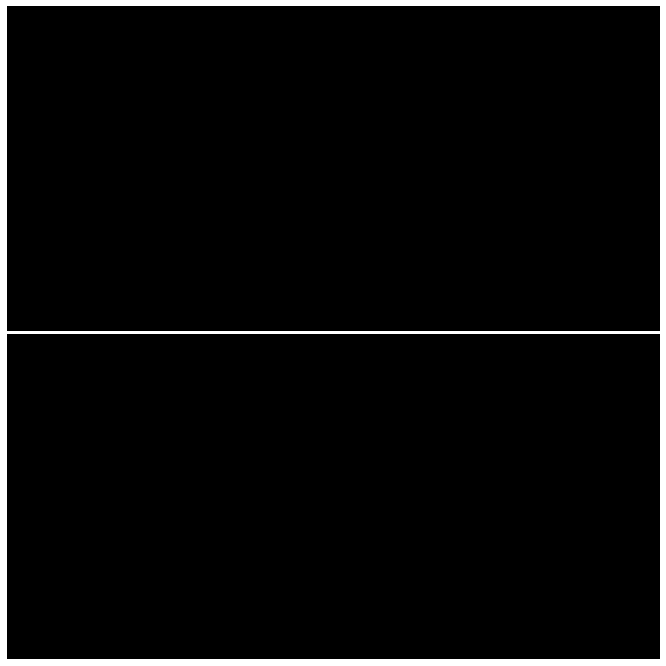

In [18]:
plt.figure(figsize=(12, 12))
plt.imshow(np.log(A +1),  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

##### Next, how does the Fourier spectrum of a 2D vertical cosine wave look like?

##### Sample rate

In [19]:
f = 0.02

In [20]:
x = y = np.arange(400)  
xx, yy = np.meshgrid(x, y)

In [21]:
vcos=normalise(np.cos(np.pi*15*f*xx))

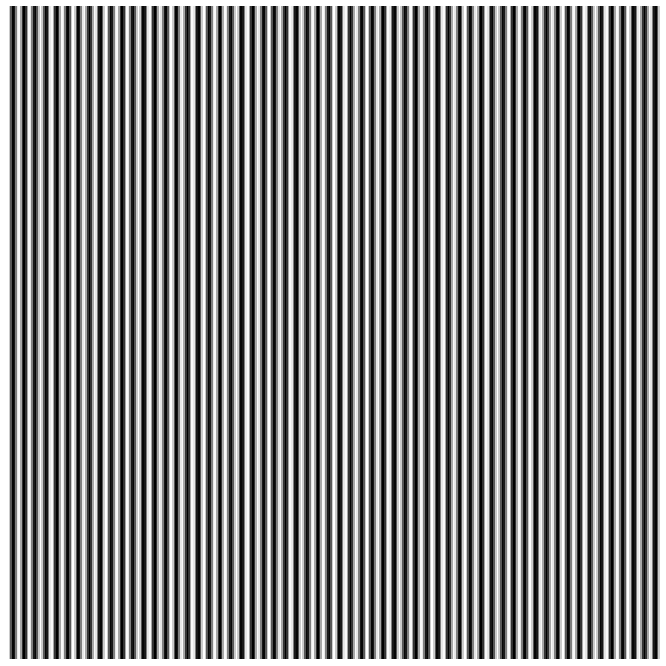

In [22]:
plt.figure(figsize=(12,12))
plt.imshow(vcos, cmap='gray', interpolation = 'none'), plt.axis('off'); 

In [23]:
A, _ = numpy_fft2(vcos)

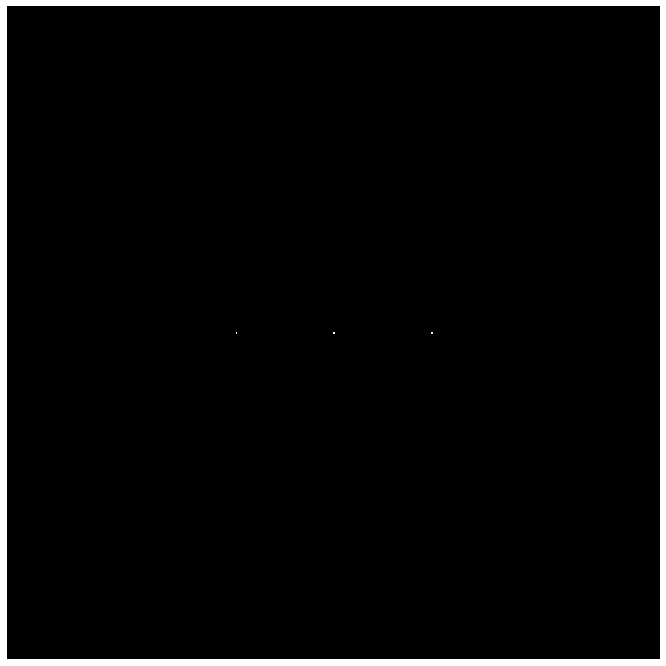

In [24]:
plt.figure(figsize=(12, 12))
plt.imshow(np.log(A +1),  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

In the image above, the center dot is the DC point. The frequency of the cosine wave is represented by the distance of either of the other points to the DC point. The amplitude information is encoded in the intensity of the points.

##### One more thing. 

Since ultimately we want to be able to filter a signal by manipulating the spectrum, then inverse Fourier transform the signal, let's show that (as should be expected) there is no signal loss by taking an image through fft2 and back via ifft2.

##### Method 1, the `numpy` way
     
That is, `ifft2(fft2(arr)) == arr` [to within a reasonable numerical accuracy](https://docs.scipy.org/doc/numpy-1.14.0/reference/generated/numpy.fft.ifft2.html) 

In [25]:
accuracy = 1e-12

In [26]:
print(np.allclose(vcos, ifft2(fft2(vcos)), accuracy, accuracy))

print(np.allclose(ifft2(fft2(vcos)), vcos, accuracy, accuracy))

True
True


##### Method 2, the `scikit-image` way

Reference: [Structural similarity index](https://scikit-image.org/docs/0.12.x/auto_examples/transform/plot_ssim.html)

In [27]:
def mse(x, y):
    return np.linalg.norm(x - y)

In [28]:
diff_mse = mse(vcos, ifft2(fft2(vcos)).real)

In [29]:
diff_ssim = compare_ssim(vcos, ifft2(fft2(vcos)).real)

In [30]:
diff = img_as_float(vcos - ifft2(fft2(vcos)).real)

In [31]:
print ('MSE: %.2E, SSIM: %.2f' % (diff_mse, diff_ssim))

MSE: 6.50E-14, SSIM: 1.00


### Create synthetic acquisition footprint

We will create a 2D acquisition footprint by combining two non-orthogonal sinusoids of different frequency.

##### First cosine wave

In [32]:
cswA=normalise(np.cos(-2*np.pi*0.5*f*xx+6*np.pi*0.5*f*yy))

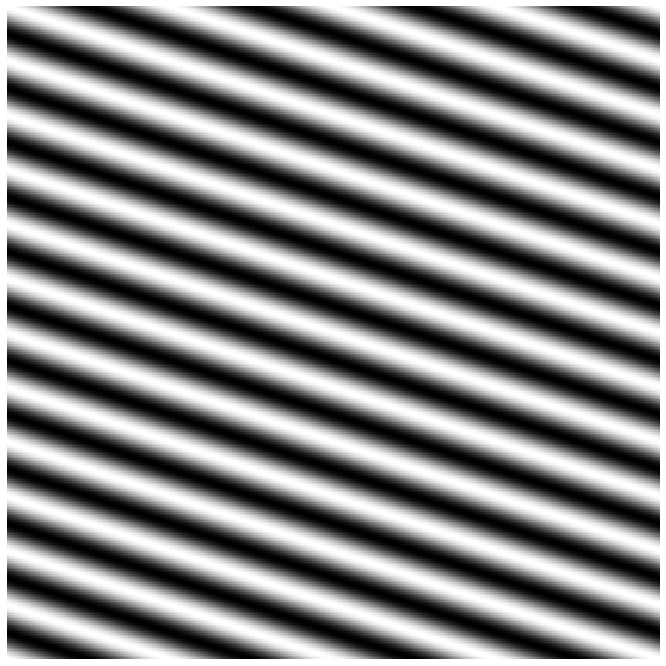

In [33]:
plt.figure(figsize=(12,12))
plt.imshow(cswA, cmap='gray', interpolation = 'none'), plt.axis('off'); 

In [34]:
A, _ = numpy_fft2(cswA)

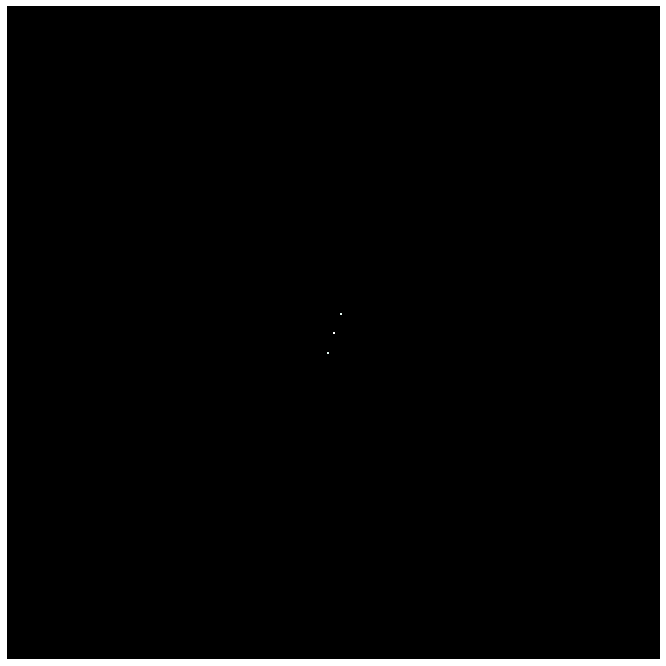

In [35]:
plt.figure(figsize=(12, 12))
plt.imshow(np.log(A +1),  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

##### Second cosine wave

In [36]:
cswB=normalise(np.cos(-15*0.6*np.pi*f*xx+1*0.6*np.pi*f*yy))
print(np.shape(cswB))

(400, 400)


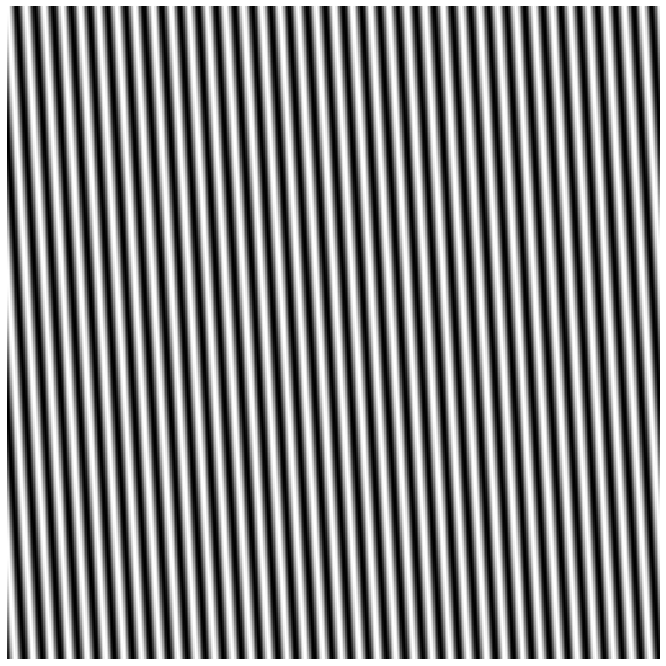

In [37]:
plt.figure(figsize=(12,12))
plt.imshow(cswB, cmap='gray', interpolation = 'none'), plt.axis('off'); 

##### Combine the two cosine waves

In [38]:
temp = cswA + cswB

In [39]:
footprint = normalise(temp)
np.shape(footprint)

(400, 400)

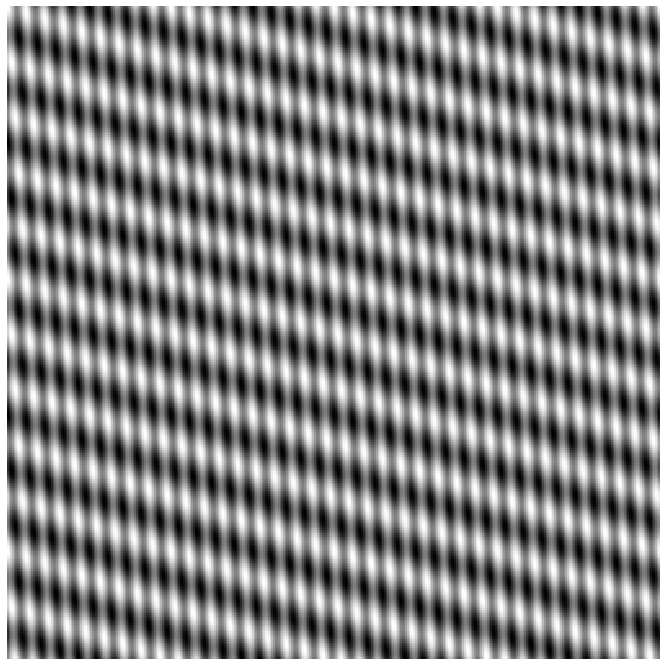

In [40]:
plt.figure(figsize=(12,12))
plt.imshow(footprint, cmap='gray', interpolation = 'none'), plt.axis('off'); 

##### Raised cosine function to taper the input _à la_ Steve Eddins, to help with DFT periodicity i artifacts

Reference blog post: [_"Fourier transform visualization using windowing"_](https://blogs.mathworks.com/steve/2009/12/04/fourier-transform-visualization-using-windowing)

In [41]:
def raised_cosine(im):
    m, n = np.shape(im)
    w1 = np.cos(np.linspace(-np.pi/2, np.pi/2, m))
    w1 = w1[:, None] 
    w2 = np.cos(np.linspace(-np.pi/2, np.pi/2, n))
    w = w1*w2
    return normalise(im * w)

In [42]:
f = raised_cosine(footprint)

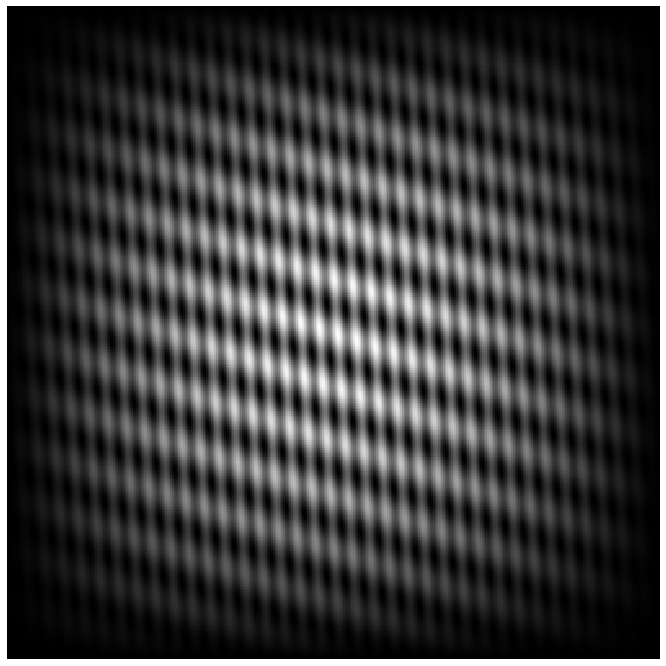

In [43]:
plt.figure(figsize=(12,12))
plt.imshow(f, cmap='gray', interpolation = 'none'), plt.axis('off'); 

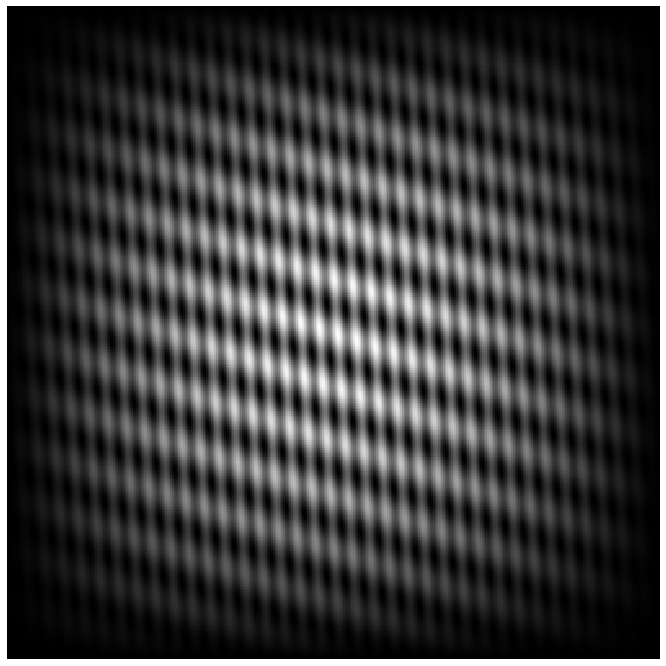

In [44]:
plt.figure(figsize=(12,12))
plt.imshow(f, cmap='gray', interpolation = 'none'), plt.axis('off'); 

In [45]:
print(np.amin(f), np.amax(f))

0.0 1.0


In [46]:
A, _ = numpy_fft2(f)

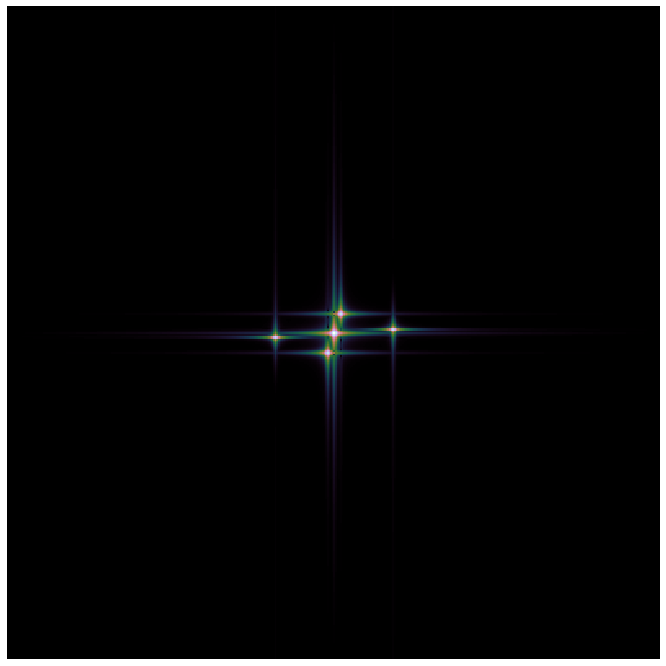

In [47]:
plt.figure(figsize=(12, 12))
plt.imshow(np.log(A +1),  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

##### For comparinson, this is the result if we do not use the tapering to remove artifacts

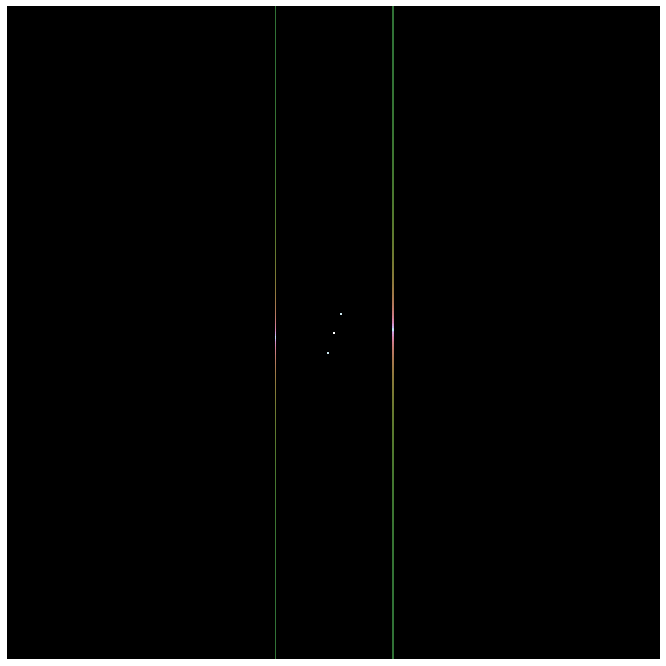

In [48]:
Au, _ = numpy_fft2(footprint)
plt.figure(figsize=(12, 12))
plt.imshow(np.log(Au +1),  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

Where do those vertical lines come from? SImilarly to what Steve showed in the blog post, now that we tiled the signal (simulating the Fourier transform's implicit periodicity) a horizontal edge effect becomes apparent.

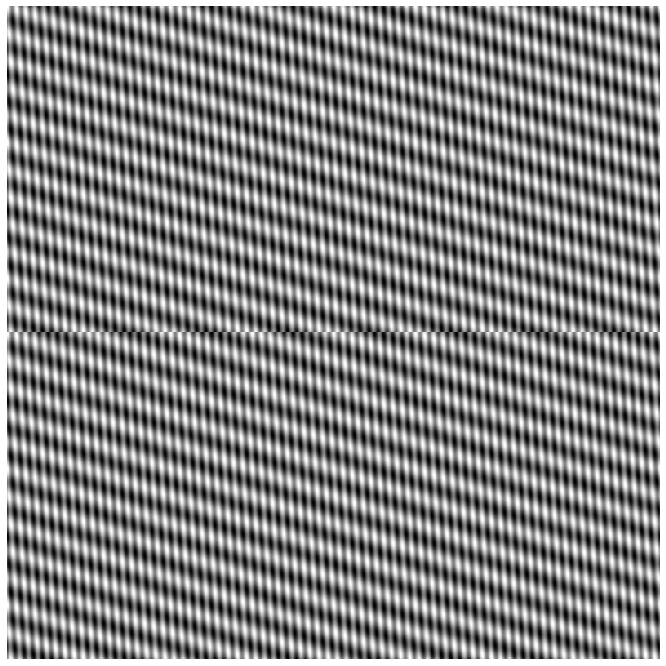

In [49]:
plt.figure(figsize=(12, 12))
plt.imshow(np.tile(footprint, (2,2)),  cmap='gray', interpolation = 'none'), plt.axis('off');

### Combine data to synthetic acquisition footprint

In [50]:
noisy = normalise(data.copy() + f*4)

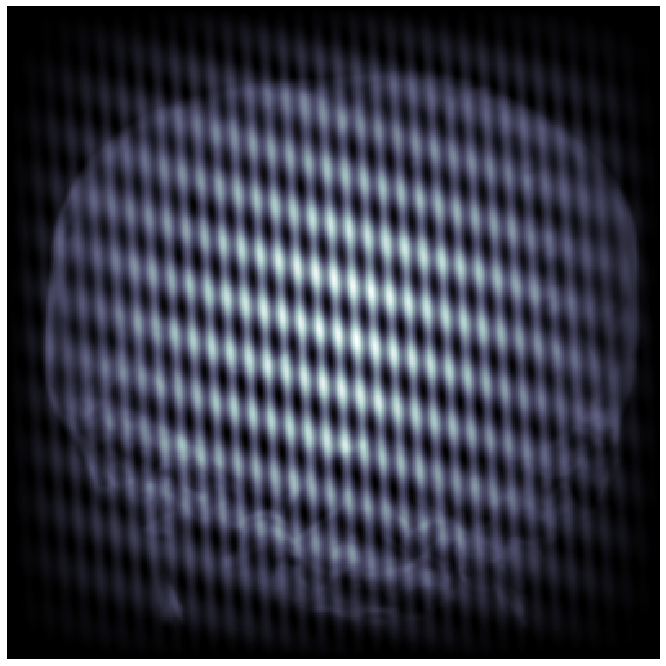

In [51]:
plt.figure(figsize=(12,12))
plt.imshow(noisy, cmap='bone'), plt.axis('off');

In [52]:
fkt = raised_cosine(noisy)

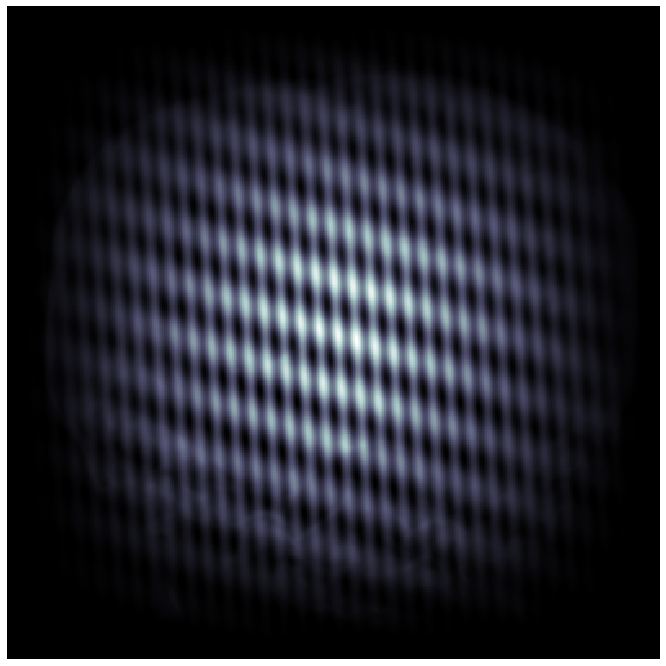

In [53]:
plt.figure(figsize=(12,12))
plt.imshow(fkt, cmap='bone', interpolation = 'none'), plt.axis('off'); 

#### Check the spectrum

In [54]:
A, _ = numpy_fft2(fkt)

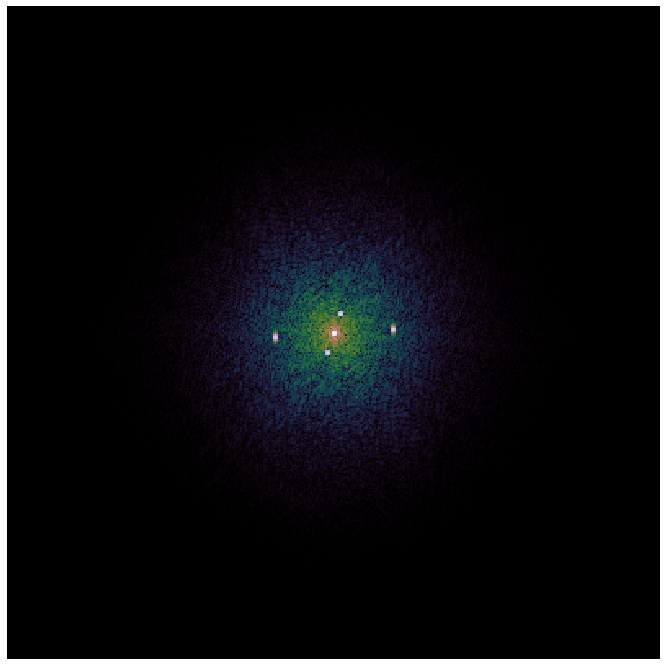

In [55]:
plt.figure(figsize=(12, 12))
plt.imshow(np.log(A +1),  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

In [56]:
Ag = denoise_tv_chambolle(np.log(A +1), weight=0.2)  

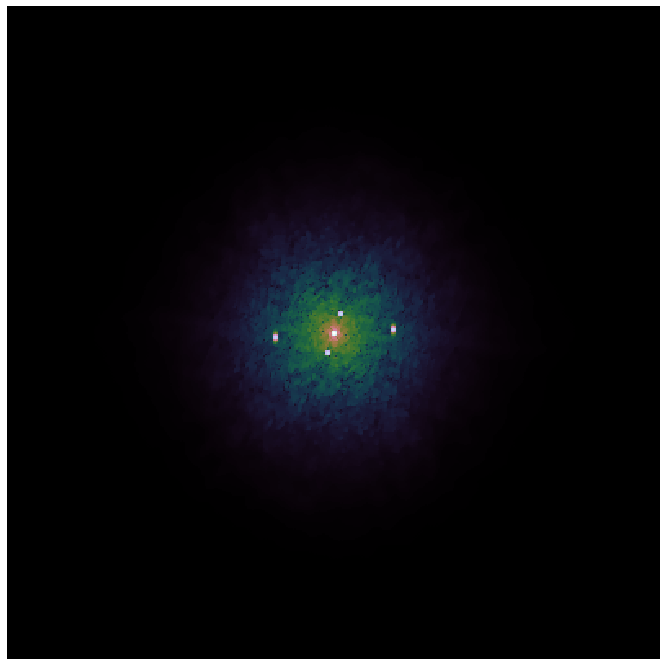

In [57]:
plt.figure(figsize=(12, 12))
plt.imshow(Ag,  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

### Filter out the footprint


##### Find local maxima in Fourier Transform image using Scikit-image 

https://scikit-image.org/docs/dev/auto_examples/segmentation/plot_peak_local_max.html

In [58]:
fp = morph.disk(5)

In [59]:
image_max = ndi.maximum_filter(Ag, footprint = fp, mode='constant')
coordinates= peak_local_max(Ag, min_distance=5, num_peaks=5)
coordinates_center = peak_local_max(Ag, min_distance=10, num_peaks=1)

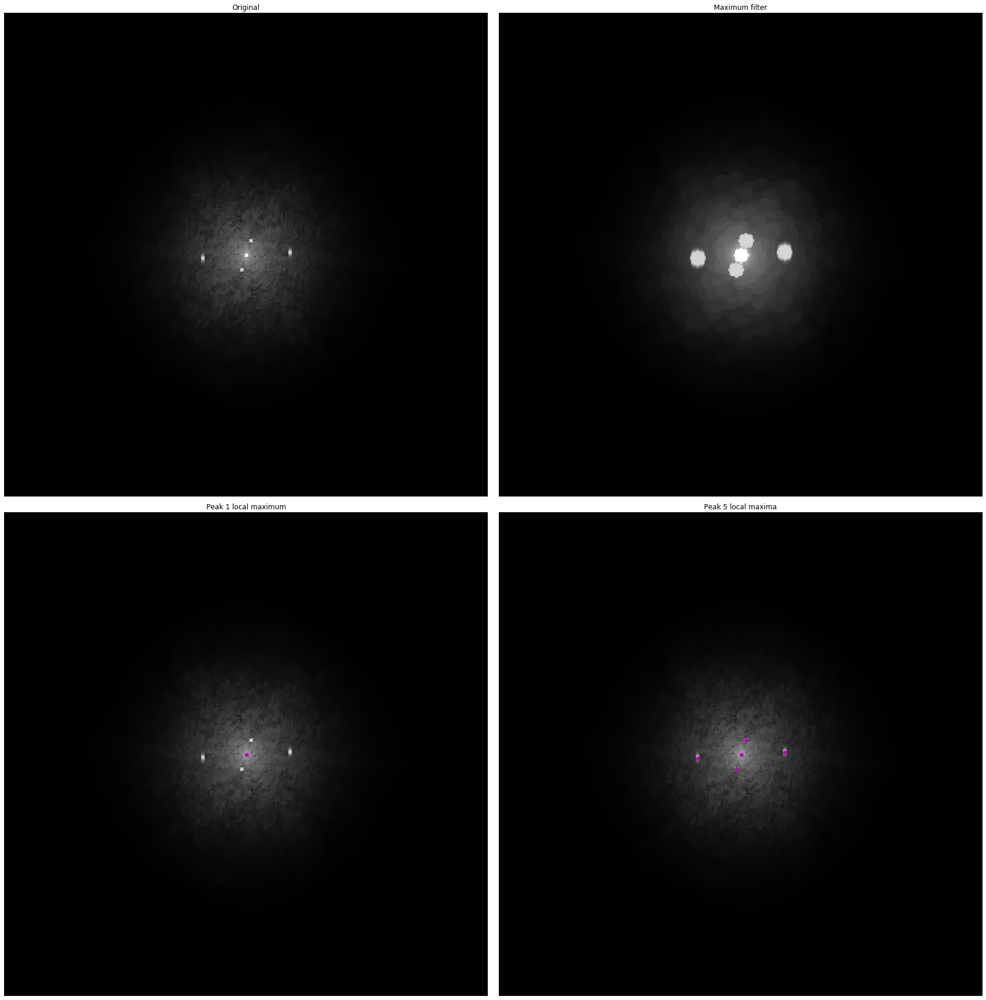

In [60]:
# display results
fig, axes = plt.subplots(2, 2, figsize=(24, 24), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(Ag, cmap='gray')
ax[0].axis('off')
ax[0].set_title('Original')

ax[1].imshow(image_max, cmap='gray')
ax[1].axis('off')
ax[1].set_title('Maximum filter')

ax[2].imshow(Ag, cmap='gray')
ax[2].autoscale(False)
ax[2].plot(coordinates_center[:, 1], coordinates_center[:, 0], 'mo')
ax[2].axis('off')
ax[2].set_title('Peak 1 local maximum')

ax[3].imshow(Ag, cmap='gray')
ax[3].autoscale(False)
ax[3].plot(coordinates[:, 1], coordinates[:, 0], 'mo')
ax[3].axis('off')
ax[3].set_title('Peak 5 local maxima')

fig.tight_layout()

plt.show()


##### Maximum filter also returns an image directly! Let's take advantage of that:

In [61]:
fttt2_im = peak_local_max(Ag, min_distance=10, num_peaks=5, indices = False)*1

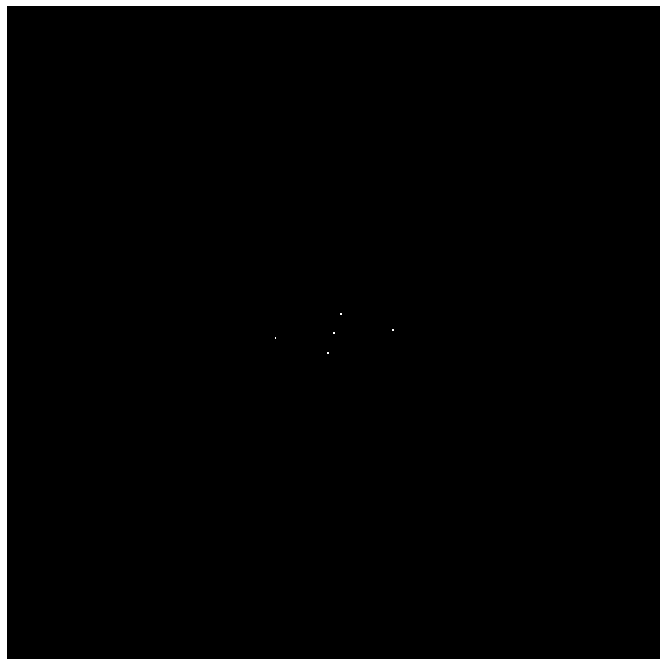

In [62]:
plt.figure(figsize=(12, 12))
plt.imshow(fttt2_im,  
           cmap='gray', interpolation = 'none'), plt.axis('off');

In [63]:
fttt2_im_center = peak_local_max(Ag, min_distance=10, num_peaks=1, indices = False)*1
fttt2_im_no_center = fttt2_im - fttt2_im_center 

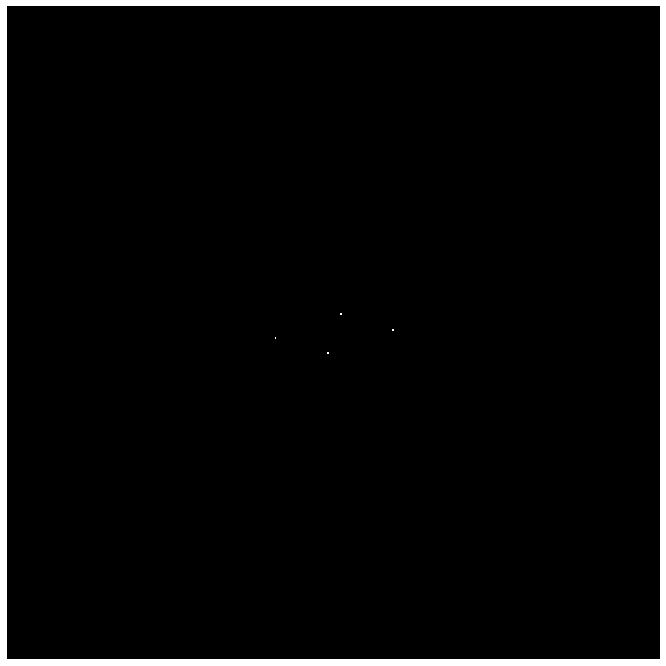

In [64]:
plt.figure(figsize=(12, 12))
plt.imshow(fttt2_im_no_center,  
           cmap='gray', interpolation = 'none'), plt.axis('off');

In [65]:
np.save('fttt2_im_no_center.npy', fttt2_im_no_center)

##### Design footprint suppression filter by convolution with Gaussian disk 

In [66]:
def scipy_gaussian_2D(std):
    '''
    2D Gaussian filter kernel similar to astropy\'s Gaussian2DKernel
    (https://docs.astropy.org/en/stable/api/astropy.convolution.Gaussian2DKernel.html#astropy.convolution.Gaussian2DKernel)
    using scipy.signal.gaussian 
    (and inspired by https://gist.github.com/thomasaarholt/267ec4fff40ca9dff1106490ea3b7567)
    
    Parameters: 
    std (int) : standard deviation of the Gaussian in pixels
    
    Returns:
    out (2D array): 2D Gaussian filter kernel
    '''
    ksp1D = signal.gaussian(std*8+1, std)
    ksp2D = np.outer(ksp1D, ksp1D)
    ksp2D /= (2*np.pi*(std**2))
    return ksp2D

In [67]:
gauss_kernel = scipy_gaussian_2D(2)
filter0 = signal.fftconvolve(fttt2_im_no_center, gauss_kernel,  mode='same')

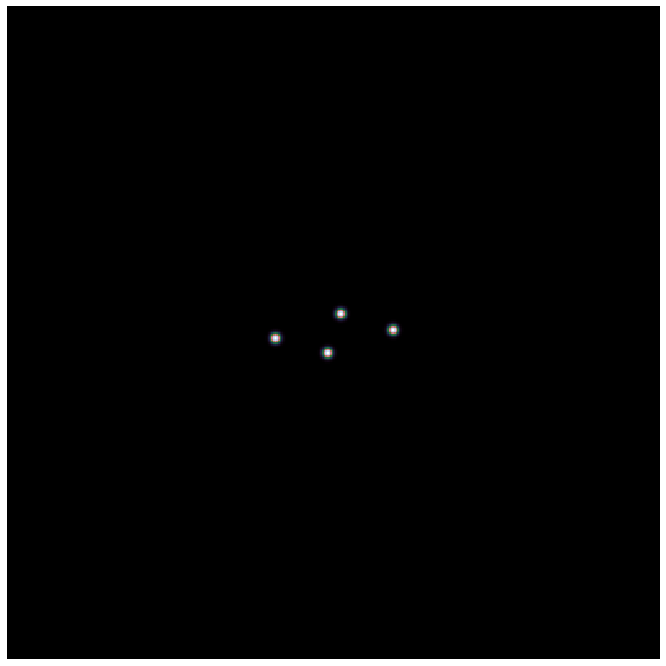

In [68]:
plt.figure(figsize=(12, 12))
plt.imshow(filter0, cmap='cubehelix', interpolation = 'none'), plt.axis('off');

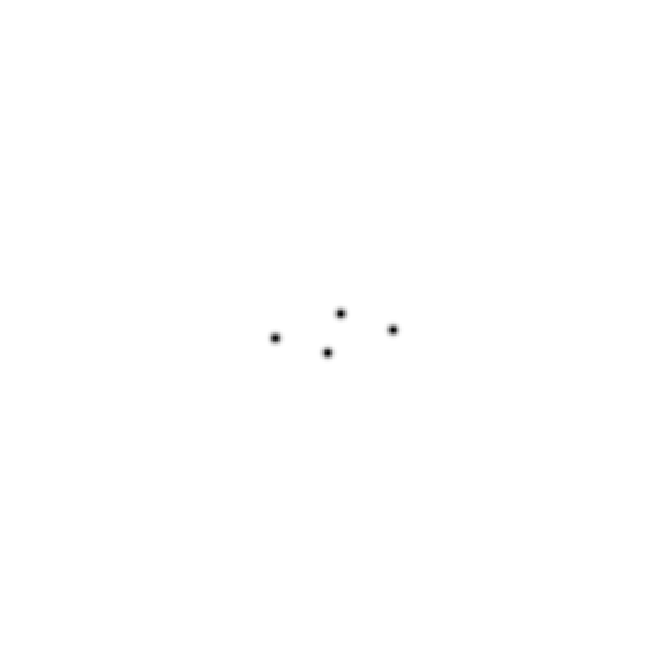

In [69]:
plt.figure(figsize=(12, 12))
plt.imshow(1-filter0, cmap='gray', interpolation = 'none'), plt.axis('off');

In [70]:
print(np.amin(filter0), np.amax(filter0))

-5.13992141030165e-18 0.03978873577297383


In [71]:
filter0=normalise(filter0)

##### Show why a gaussian kernel filter is better than a disk notch filter

In [72]:
c1 = np.zeros((500, 500, 3), 'float')
rr, cc = circle(250, 250, 15, c1.shape)
c1[rr,cc] = (1.)
c1=rgb2gray(c1)

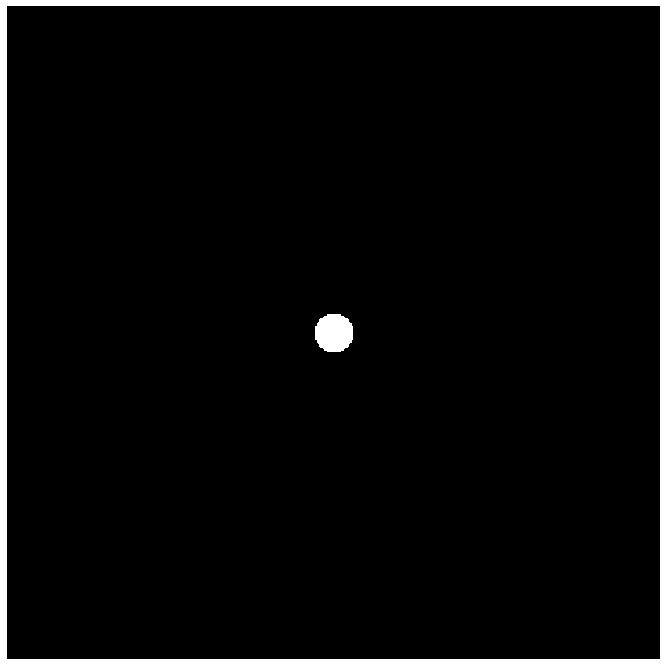

In [73]:
plt.figure(figsize=(12, 12))
plt.imshow(c1, cmap='gray', interpolation = 'none'), plt.axis('off');

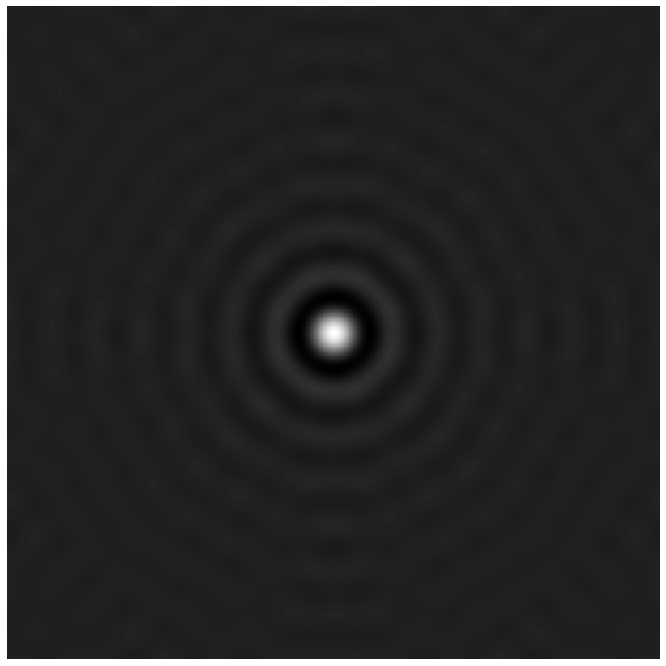

In [74]:
plt.figure(figsize=(12, 12))
plt.imshow(fftshift(ifft2(ifftshift(c1))).real, cmap='gray', interpolation = 'none'), plt.axis('off');

In [75]:
c2 = signal.fftconvolve(c1, scipy_gaussian_2D(7),  mode='same')

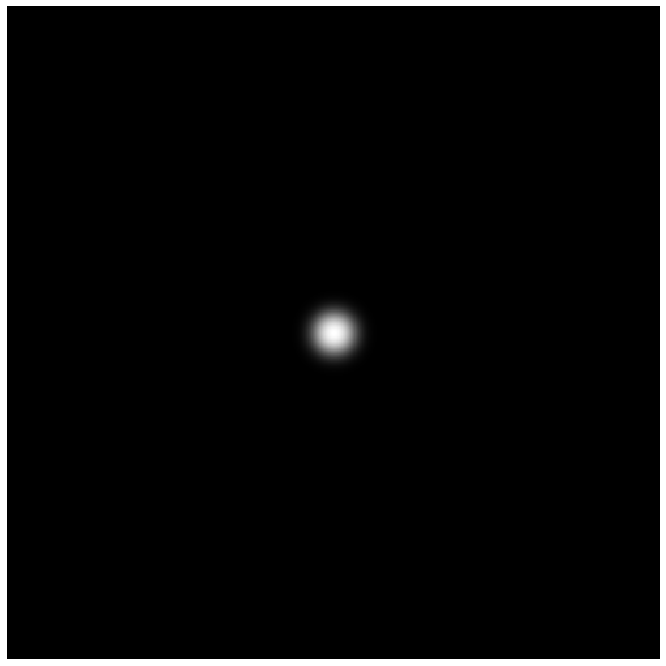

In [76]:
plt.figure(figsize=(12, 12))
plt.imshow(c2, cmap='gray', interpolation = 'none'), plt.axis('off');

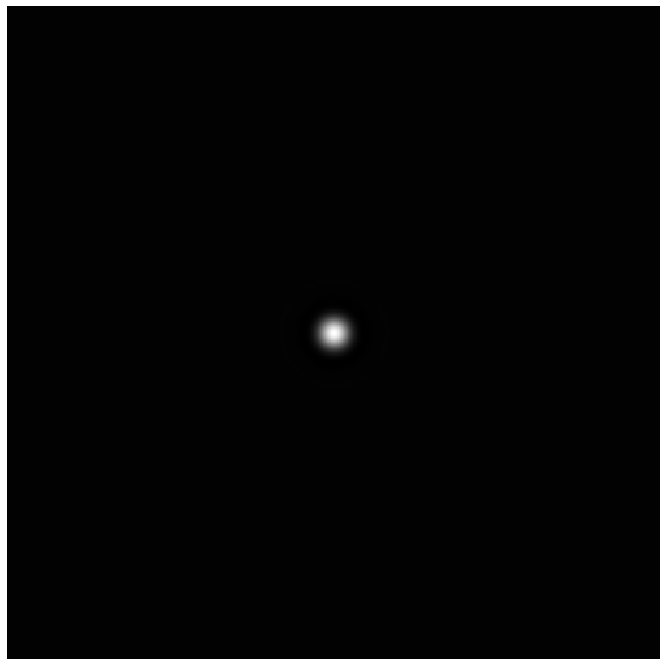

In [77]:
plt.figure(figsize=(12, 12))
plt.imshow(fftshift(ifft2(ifftshift(c2))).real, cmap='gray', interpolation = 'none'), plt.axis('off');

##### Apply filter and check reconstructed cat scan image

In [78]:
filtered = ifft2(np.multiply(ifftshift(1-filter0), fft2(data.copy()))).real

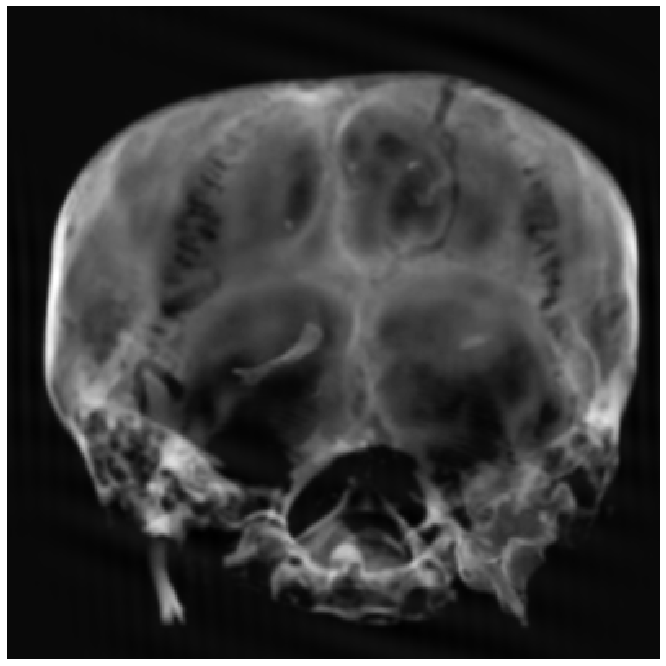

In [79]:
plt.figure(figsize=(12, 12))
plt.imshow(filtered, cmap='gray', interpolation = 'none'), plt.axis('off');

##### Check effect of filtering on Canny edge effectiveness

In [80]:
def auto_canny(img, sigma = 0.33):
    """Zero-parameter, automatic Canny edge detection using scikit-image.
    Original function from pyimagesearch: Zero-parameter, automatic Canny edge with with Python and OpenCV
    www.pyimagesearch.com/2015/04/06/zero-parameter-automatic-canny-edge-detection-with-python-and-opencv"""
        
    # compute the median of the single channel pixel intensities
    v = np.median(img)
 
    # apply automatic Canny edge detection using the computed median
    lower = float(max(0.0, (1.0 - sigma) * v))
    upper = float(min(1.0, (1.0 + sigma) * v))
    edged = canny(img, sigma, lower, upper)

    # return the edged image
    return edged

In [81]:
Cn = auto_canny(noisy)

In [82]:
Cdn = auto_canny(filtered)

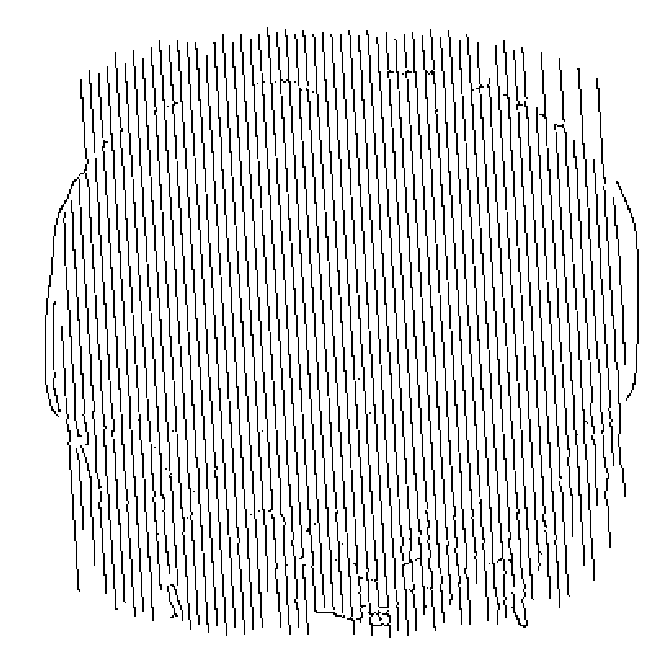

In [83]:
plt.figure(figsize=(12, 12))
plt.imshow(Cn, cmap='gray_r', interpolation = 'none'), plt.axis('off');

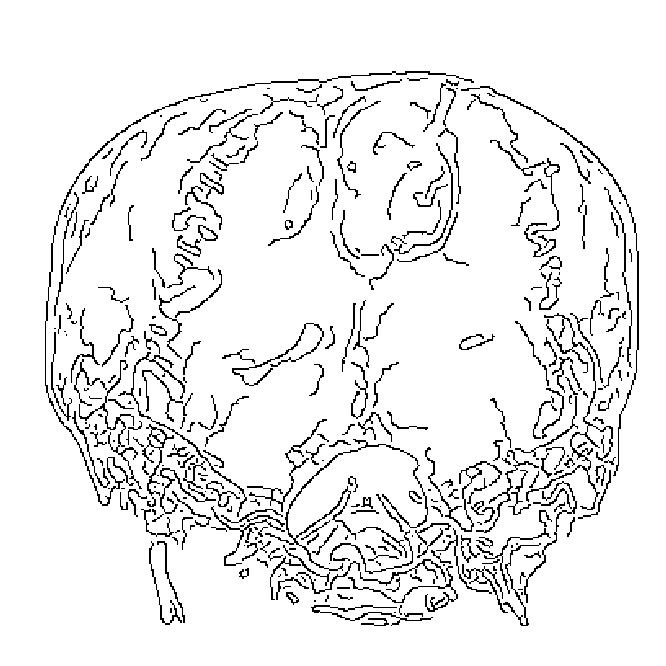

In [84]:
plt.figure(figsize=(12, 12))
plt.imshow(Cdn, cmap='gray_r', interpolation = 'none'), plt.axis('off');

##### Check effect of filtering on sobel filters effectiveness (1D and 2D)

In [85]:
Snh = ndi.sobel(noisy,0)
Sdnh = ndi.sobel(filtered,0)

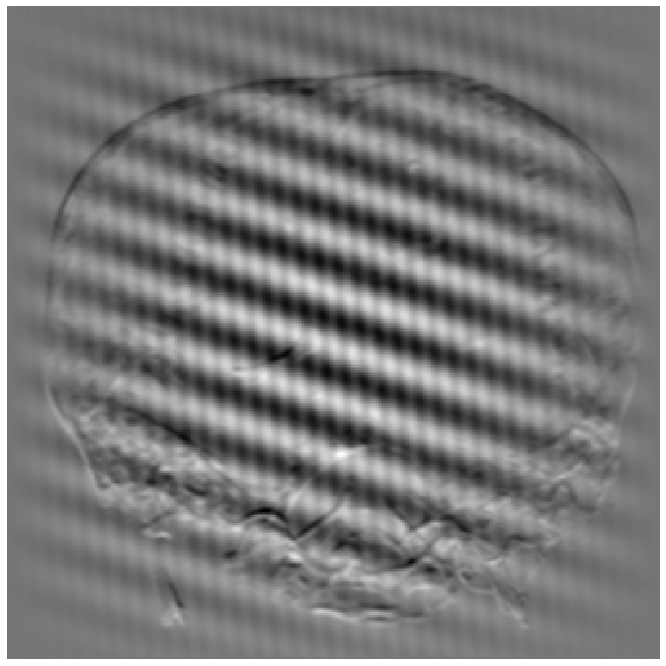

In [86]:
plt.figure(figsize=(12, 12))
plt.imshow(Snh, cmap='gray_r', interpolation = 'none'), plt.axis('off');

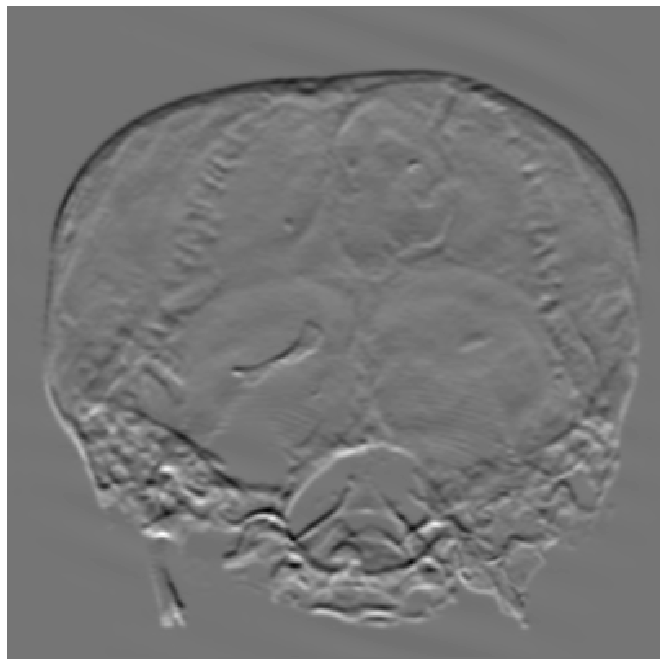

In [87]:
plt.figure(figsize=(12, 12))
plt.imshow(Sdnh, cmap='gray_r', interpolation = 'none'), plt.axis('off');

In [88]:
Snv = ndi.sobel(noisy,1)
Sdnv = ndi.sobel(filtered,1)

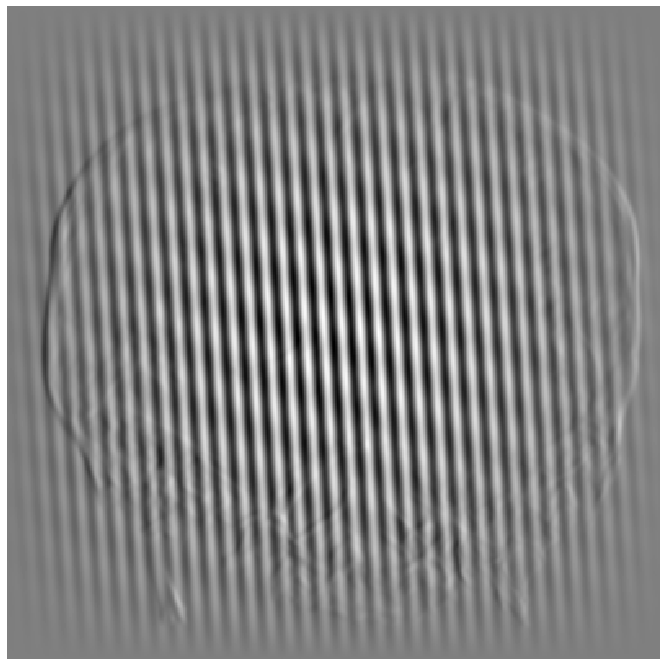

In [89]:
plt.figure(figsize=(12, 12))
plt.imshow(Snv, cmap='gray_r', interpolation = 'none'), plt.axis('off');

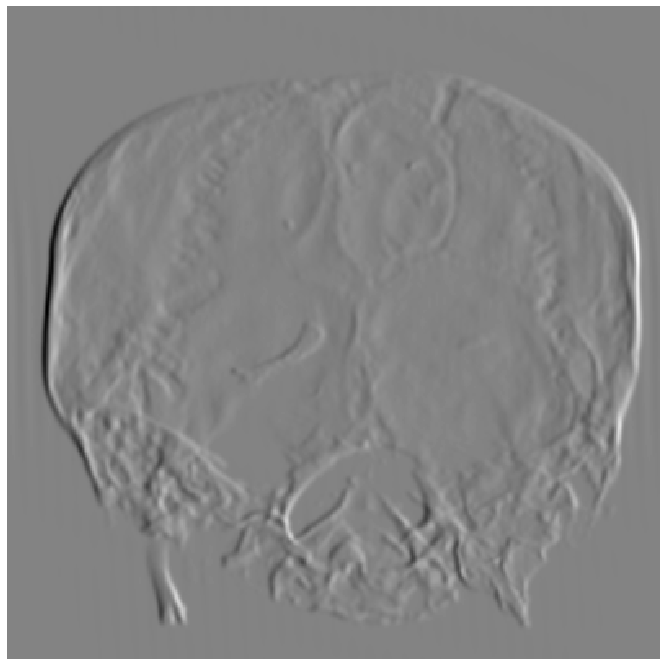

In [90]:
plt.figure(figsize=(12, 12))
plt.imshow(Sdnv, cmap='gray_r', interpolation = 'none'), plt.axis('off');

In [91]:
def Sobel_2d(im):
    '''2D Sobel filter'''
    dx = ndi.sobel(data, 0)  # horizontal derivative
    dy = ndi.sobel(data, 1)  # vertical derivative
    mag = np.hypot(dx, dy)      # magnitude
    mag *= 255.0 / np.max(mag)  # normalize
    return mag

In [92]:
Sn2 = Sobel_2d(noisy)

In [93]:
Sdn2 = Sobel_2d(filtered)

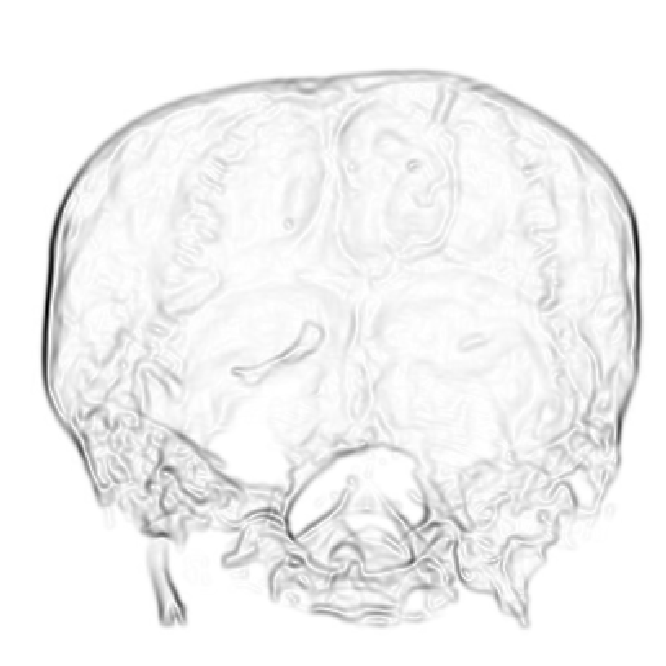

In [94]:
plt.figure(figsize=(12, 12))
plt.imshow(Sn2, cmap='gray_r', interpolation = 'none'), plt.axis('off');

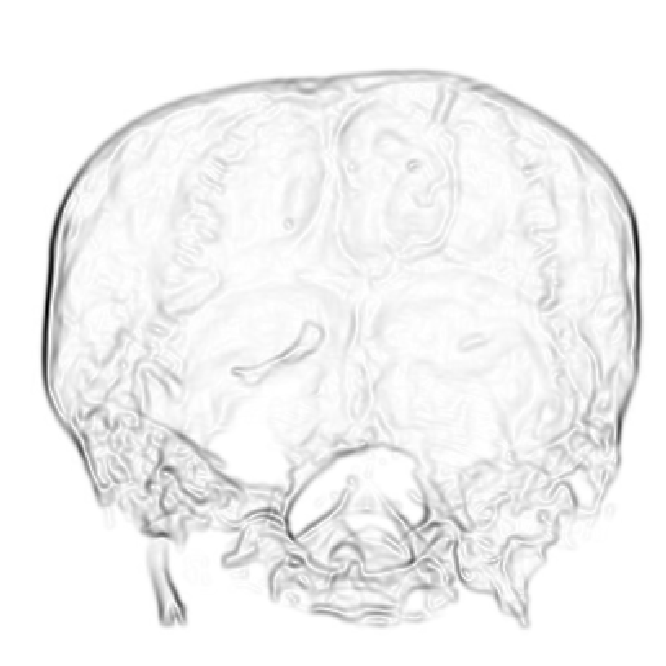

In [95]:
plt.figure(figsize=(12, 12))
plt.imshow(Sdn2, cmap='gray_r', interpolation = 'none'), plt.axis('off');

### Some real seismic data now

##### Function to pad input to a square NxN array. Not necessary in this case because images are square to begin with.

In [96]:
def pad_next_square_size(im):
    """Function to pad a rectangualr image to a square image.
    Parameters:
    im (2D array): input grayscale image
    
    Returns:
    out (2D array): padded input image
    padding (slice object): a slice object that can be used later on to unpad
    
    Example:
    out, padding = pad_next_square_size(im)
    """
    m, n = np.shape(im) # get input shape
    deficit = max([m,n])- min([m,n])  # get deficit between size lengths

    # difference in dimensions is even, pad both sides of short dimension by deficit//2
    if deficit%2 == 0: 
        deficit1 = deficit//2
        deficit2 = deficit//2
    
    # difference in dimensions is odd, pad one side by deficit//2 +1
    else:
        deficit1 = deficit//2
        deficit2 = deficit1+1
        
    if m > n:
        print("Padded image columns")
        return (np.pad(im,((0,0), (deficit1,deficit2)), 'reflect'), slice(deficit1, -deficit2))
        
    else:
        print("Padded image rows")
        return (np.pad(im,((deficit1,deficit2), (0,0)), 'reflect'), slice(deficit1, -deficit2))

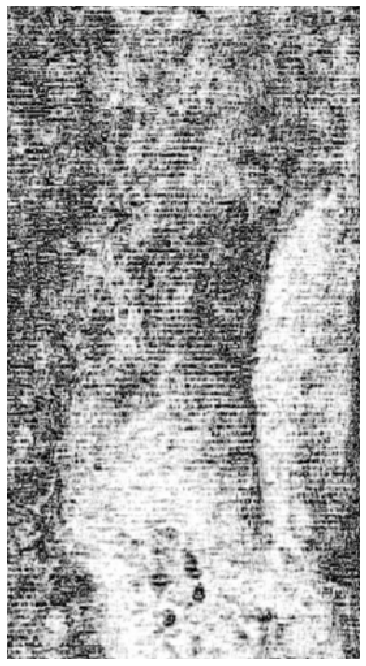

In [97]:
sc = normalise(rgb2gray(io.imread('Luo_edge-preserving_smoothing.png')))
plt.figure(figsize=(12, 12))
plt.imshow(sc, cmap='gray', interpolation = 'none'), plt.axis('off');

In [98]:
print (np.shape(sc))
print(np.amax(sc))

(502, 271)
1.0


In [99]:
test1, slc = pad_next_square_size(sc)

Padded image columns


In [100]:
slc

slice(115, -116, None)

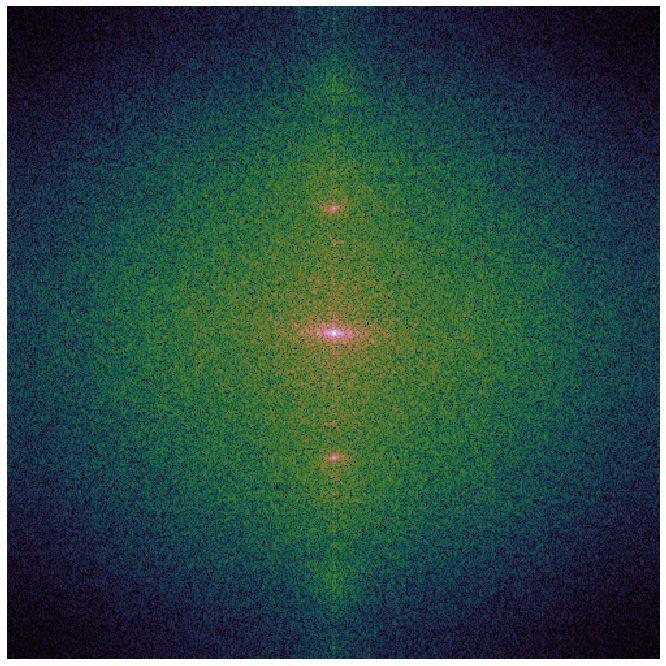

In [101]:
A, _ = numpy_fft2(raised_cosine(test1))
plt.figure(figsize=(12, 12))
plt.imshow(np.log(A +1),  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

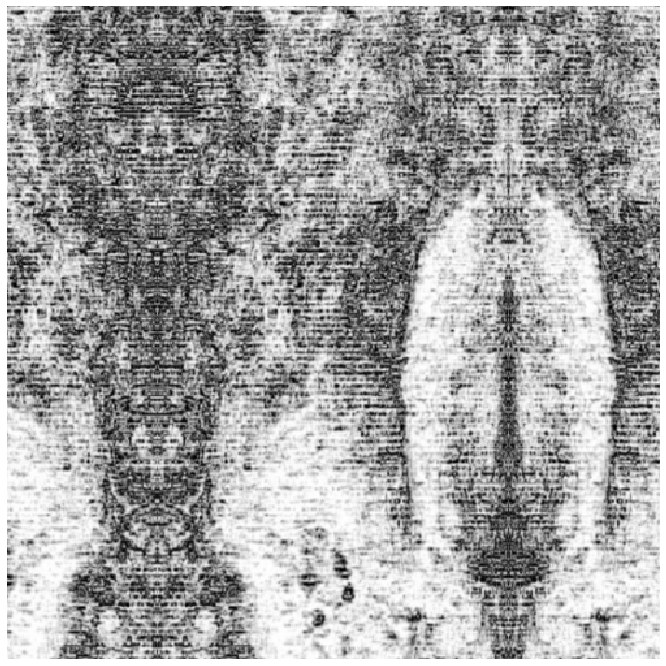

In [102]:
plt.figure(figsize=(12, 12))
plt.imshow(test1, cmap='gray', interpolation = 'none'), plt.axis('off');

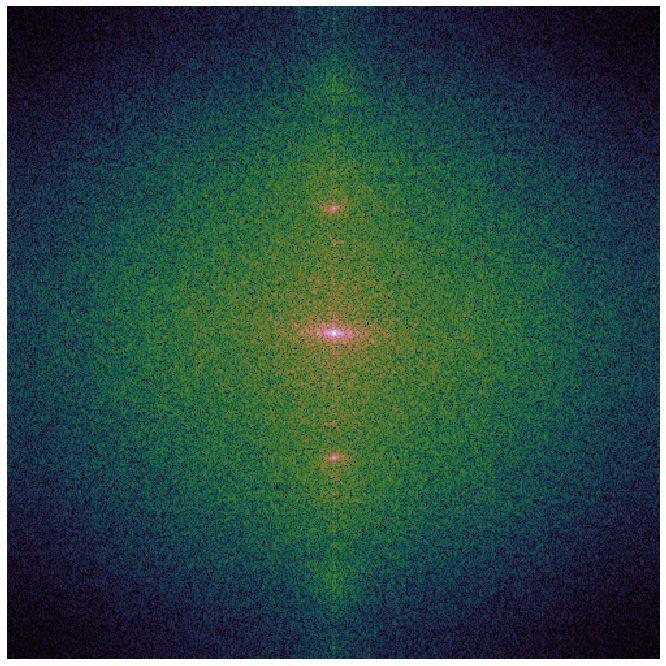

In [103]:
A, _ = numpy_fft2(raised_cosine(test1))
plt.figure(figsize=(12, 12))
plt.imshow(np.log(A +1),  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

In [104]:
Ag = denoise_tv_chambolle(np.log(A +1), weight=0.2)  

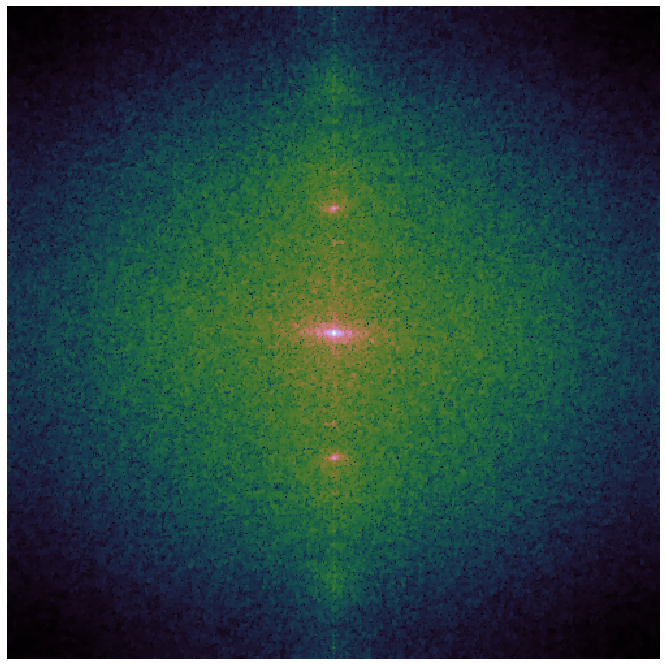

In [105]:
plt.figure(figsize=(12, 12))
plt.imshow(Ag,  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

In [106]:
image_max = ndi.maximum_filter(Ag, footprint = fp, mode='constant')
coordinates= peak_local_max(Ag, min_distance=10, num_peaks=5)
coordinates_center = peak_local_max(Ag, min_distance=10, num_peaks=1)

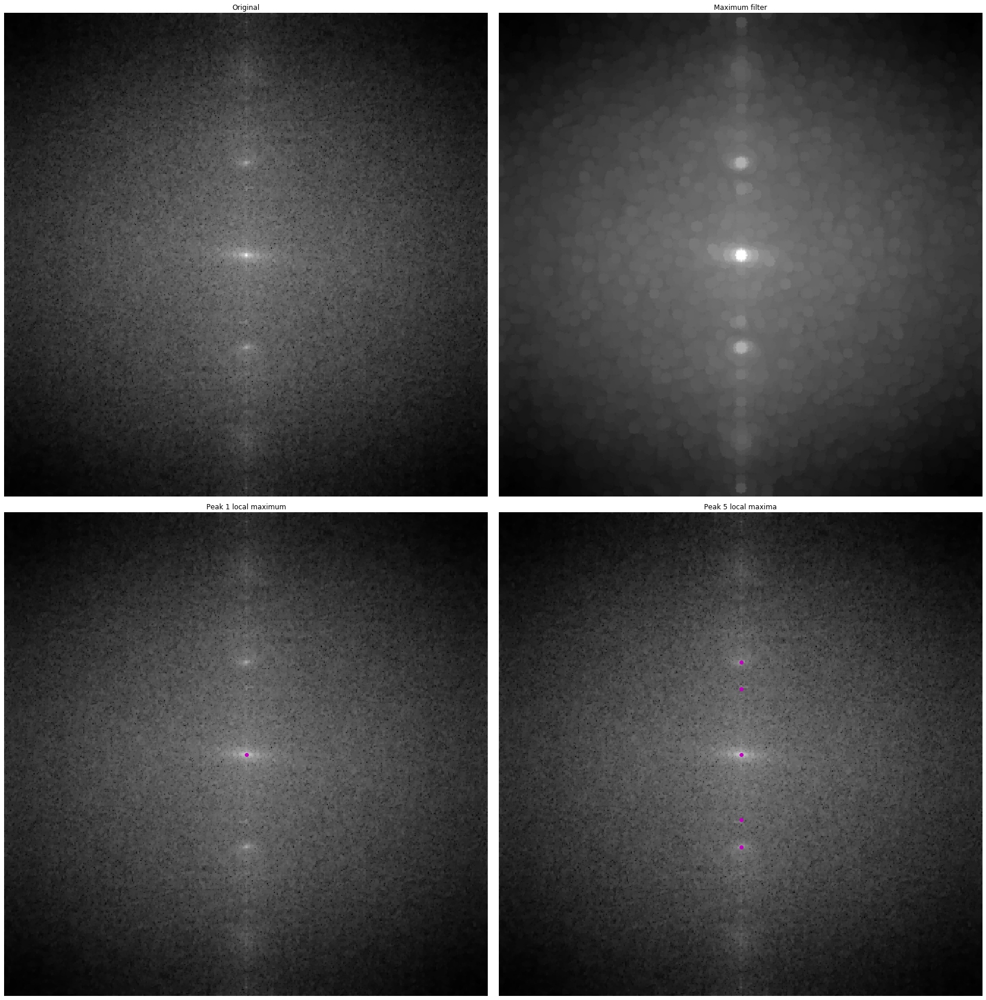

In [107]:
# display results
fig, axes = plt.subplots(2, 2, figsize=(24, 24), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(Ag, cmap='gray')
ax[0].axis('off')
ax[0].set_title('Original')

ax[1].imshow(image_max, cmap='gray')
ax[1].axis('off')
ax[1].set_title('Maximum filter')

ax[2].imshow(Ag, cmap='gray')
ax[2].autoscale(False)
ax[2].plot(coordinates_center[:, 1], coordinates_center[:, 0], 'mo')
ax[2].axis('off')
ax[2].set_title('Peak 1 local maximum')

ax[3].imshow(Ag, cmap='gray')
ax[3].autoscale(False)
ax[3].plot(coordinates[:, 1], coordinates[:, 0], 'mo')
ax[3].axis('off')
ax[3].set_title('Peak 5 local maxima')

fig.tight_layout()

plt.show()

In [108]:
fttt2_im = peak_local_max(Ag, min_distance=10, num_peaks=5, indices = False)*1

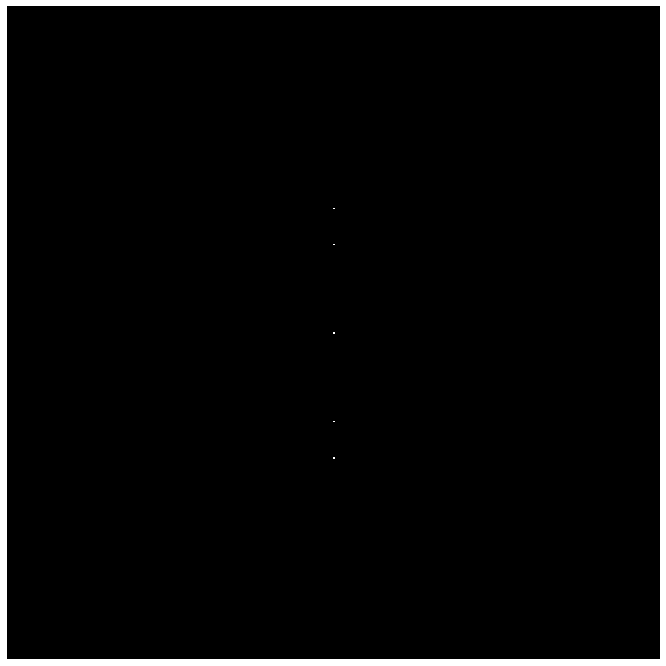

In [109]:
plt.figure(figsize=(12, 12))
plt.imshow(fttt2_im,  
           cmap='gray', interpolation = 'none'), plt.axis('off');

In [110]:
fttt2_im_center = peak_local_max(Ag, min_distance=10, num_peaks=1, indices = False)*1
fttt2_im_no_center = fttt2_im - fttt2_im_center 

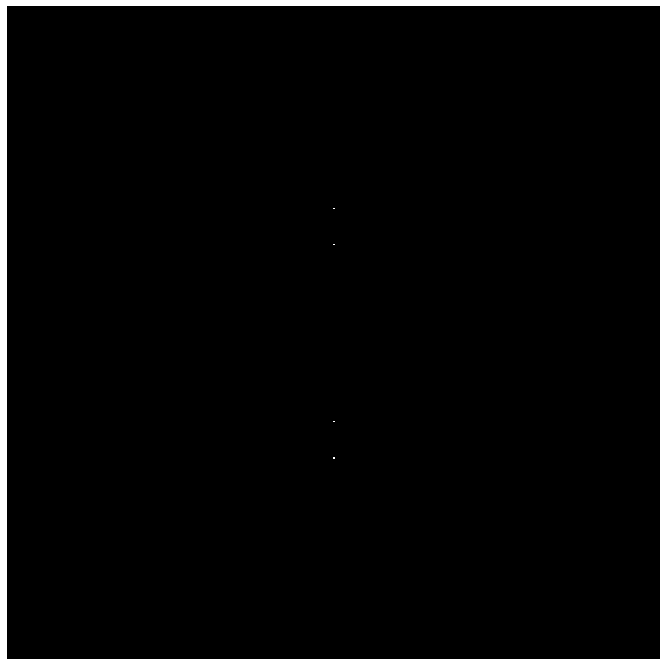

In [111]:
plt.figure(figsize=(12, 12))
plt.imshow(fttt2_im_no_center,  
           cmap='gray', interpolation = 'none'), plt.axis('off');

##### Design footprint suppression filter by convolution with Gaussian disk 

Using `astropy`:
https://docs.astropy.org/en/stable/convolution/kernels.html

In [112]:
gauss_kernel1 = scipy_gaussian_2D(5)
filter1 = signal.fftconvolve(fttt2_im_no_center, gauss_kernel,  mode='same')

print (np.amin(filter1))
print (np.amax(filter1))

filter1=normalise(filter1)
print (np.amin(filter1))
print (np.amax(filter1))

-6.579099405186113e-18
0.03978873577297383
0.0
1.0


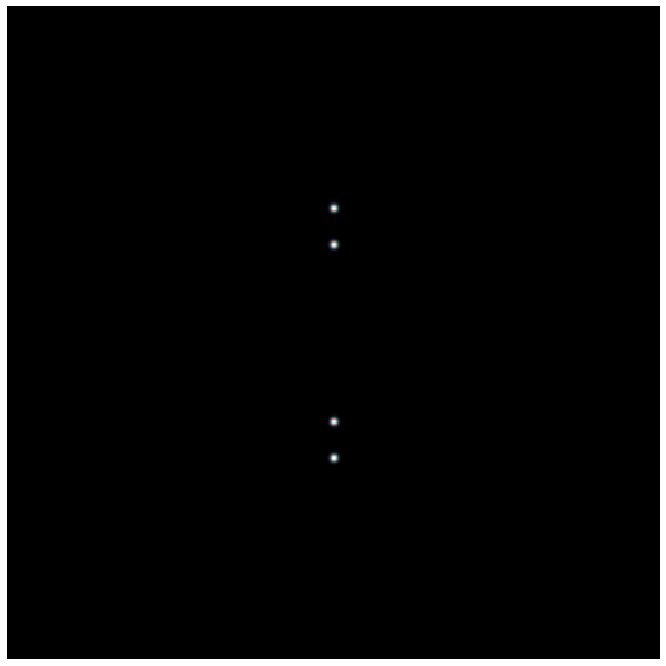

In [113]:
plt.figure(figsize=(12, 12))
plt.imshow(filter1, cmap='cubehelix', interpolation = 'none'), plt.axis('off');

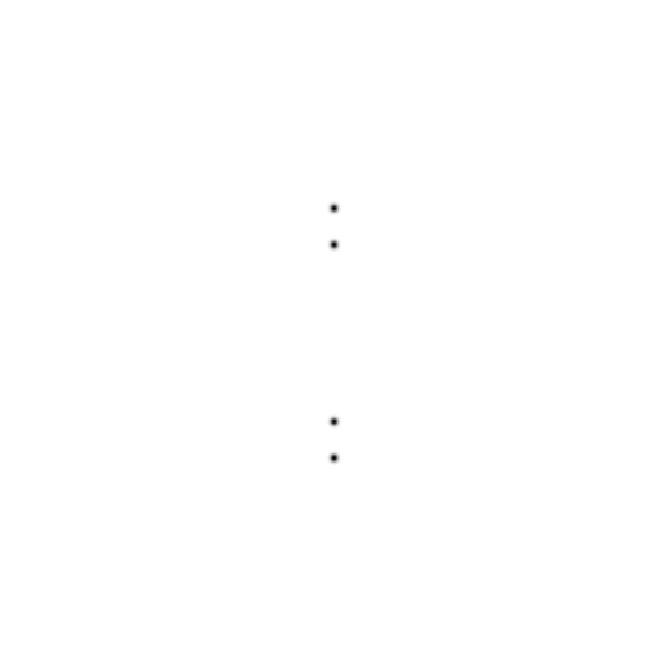

In [114]:
plt.figure(figsize=(12, 12))
plt.imshow(1-filter1, cmap='gray', interpolation = 'none'), plt.axis('off');

In [115]:
print (np.shape(test1))
print (np.shape(filter1))
print (np.shape(Ag))

(502, 502)
(502, 502)
(502, 502)


##### Apply filter and view reconstructed image

In [116]:
def reverse_padding(im, filtered_im, slc):
    m, n = np.shape(im) # get input shape
     
    if m > n:
        print("Unpadding image columns")
        return filtered_im[:, slc]       
    else:
        print("Unpadding image rows")
        return filtered_im[slc, :]      

In [117]:
filtered1 = ifft2(np.multiply(ifftshift(1-filter1), fft2(test1.copy()))).real
print(np.shape(filtered1))

filtered1 = reverse_padding(sc, filtered1, slc)
print(np.shape(filtered1))

(502, 502)
Unpadding image columns
(502, 271)


In [118]:
compare_ssim(sc, filtered1)

0.9543649341053501

In [119]:
diff = img_as_float(sc - filtered1)

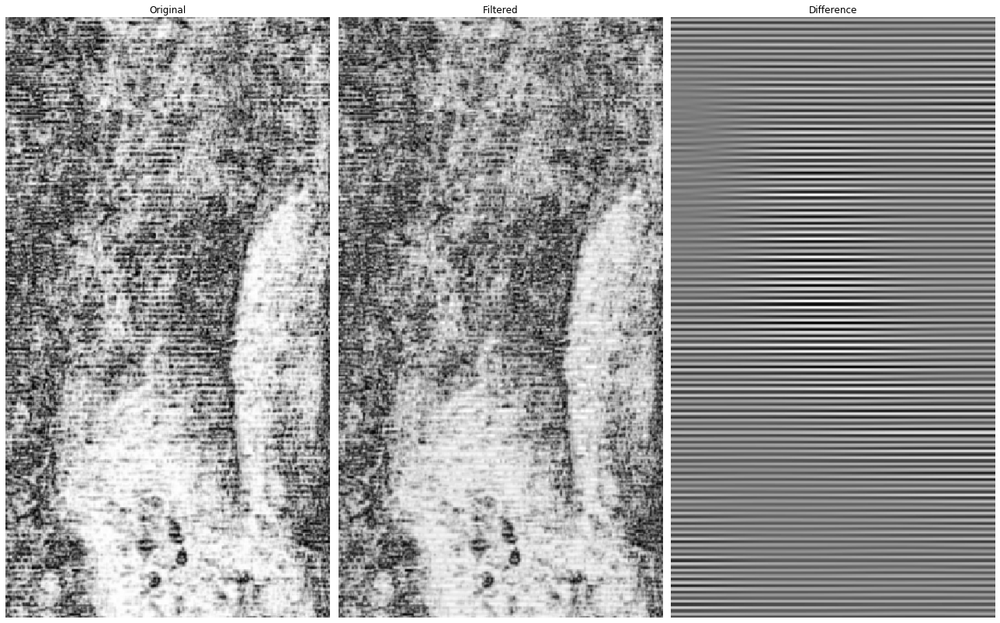

In [120]:
# display results
fig, axes = plt.subplots(1, 3, figsize=(18, 12), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(sc, cmap='gray')
ax[0].axis('off')
ax[0].set_title('Original')

ax[1].imshow(filtered1, cmap='gray')
ax[1].axis('off')
ax[1].set_title('Filtered')

ax[2].imshow(diff, cmap='gray')
ax[2].axis('off')
ax[2].set_title('Difference')

fig.tight_layout()

plt.show()


#### Some open data now

In [121]:
data = np.genfromtxt('F3_demo6_amplitude.txt', delimiter='\t', usecols=(0, 1, 3))

In [122]:
inlines = np.amax(data[:,0]).astype(int) - np.amin(data[:,0]).astype(int) + 1
xlines = np.amax(data[:,1]).astype(int) - np.amin(data[:,1]).astype(int) + 1

print(np.amax(data[:,0]), np.amin(data[:,0]), inlines)
print(np.amax(data[:,1]), np.amin(data[:,1]), xlines)

data[:,0] = inlines - (data[:,0] - np.amin(data[:,0])) 
data[:,1] -= 303

748.0 104.0 645
1248.0 302.0 947


In [123]:
horizon = np.empty((inlines, xlines))

for sample in data:
    inline = sample[0]
    xline = sample[1]
    z_value = sample[2]
    
    # We have to subtract 1 to allow for 0-based indexing
    horizon[(inline-1).astype(int), (xline-1).astype(int)] = z_value

In [124]:
mi = np.amin(horizon)
ma = np.amax(horizon)
print(mi, ma)

-23221.0 1e+30


In [125]:
horizon=normalise(horizon[100::,:])
mi = np.amin(horizon)
ma = np.amax(horizon)
print(mi, ma)

0.0 1.0


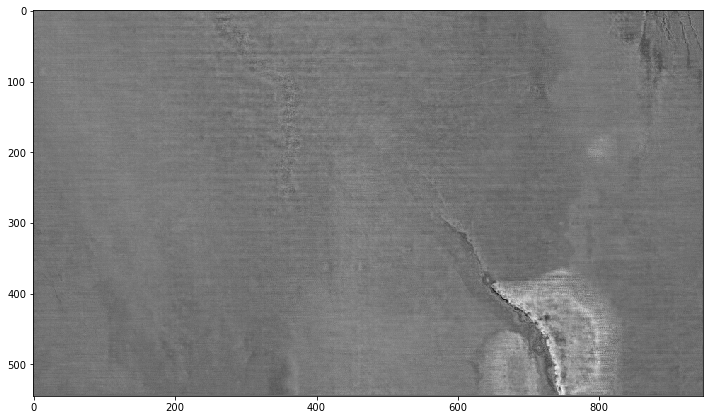

In [126]:
plt.figure(figsize=(12,12))
plt.imshow(horizon, cmap=plt.get_cmap('gray'))
plt.show();

In [127]:
test1, slc = pad_next_square_size(horizon)

Padded image rows


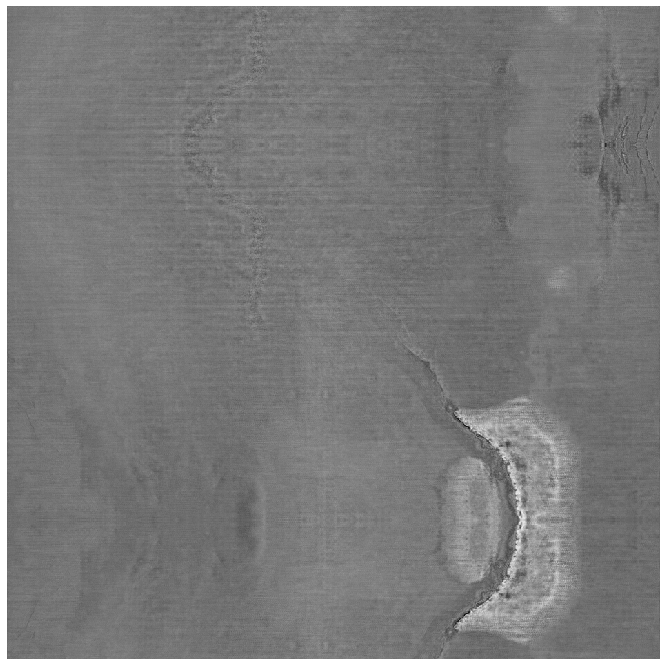

In [128]:
plt.figure(figsize=(12, 12))
plt.imshow(test1, cmap='gray', interpolation = 'none'), plt.axis('off');

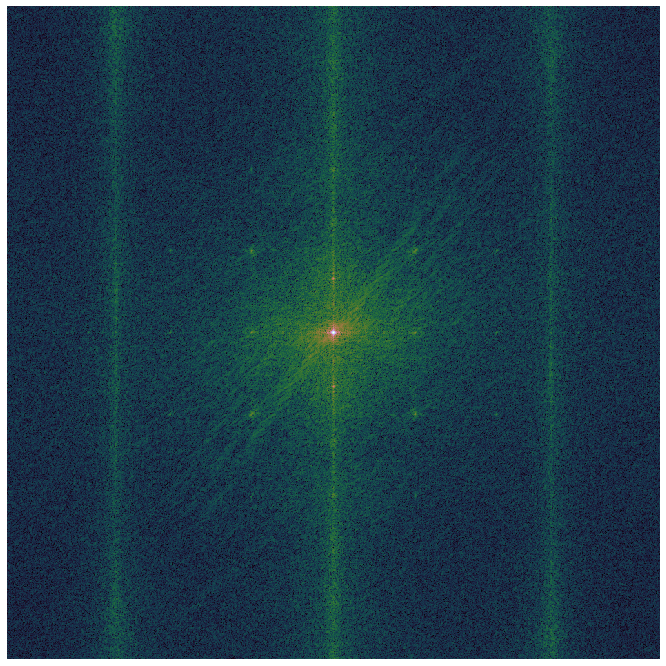

In [129]:
A, _ = numpy_fft2(raised_cosine(test1))
plt.figure(figsize=(12, 12))
plt.imshow(np.log(A +1),  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

In [130]:
Ag = denoise_tv_chambolle(np.log(A +1), weight=0.2)  

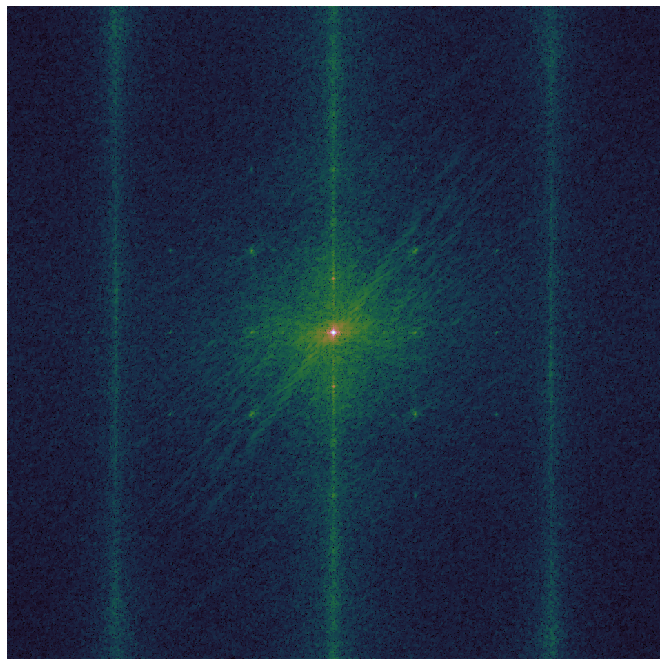

In [131]:
plt.figure(figsize=(12, 12))
plt.imshow(Ag,  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

In [132]:
fp = morph.disk(12)

In [133]:
image_max = ndi.maximum_filter(Ag, footprint = fp, mode='constant')
coordinates= peak_local_max(Ag, min_distance=25, num_peaks=47)
coordinates_center = peak_local_max(Ag, min_distance=10, num_peaks=1)

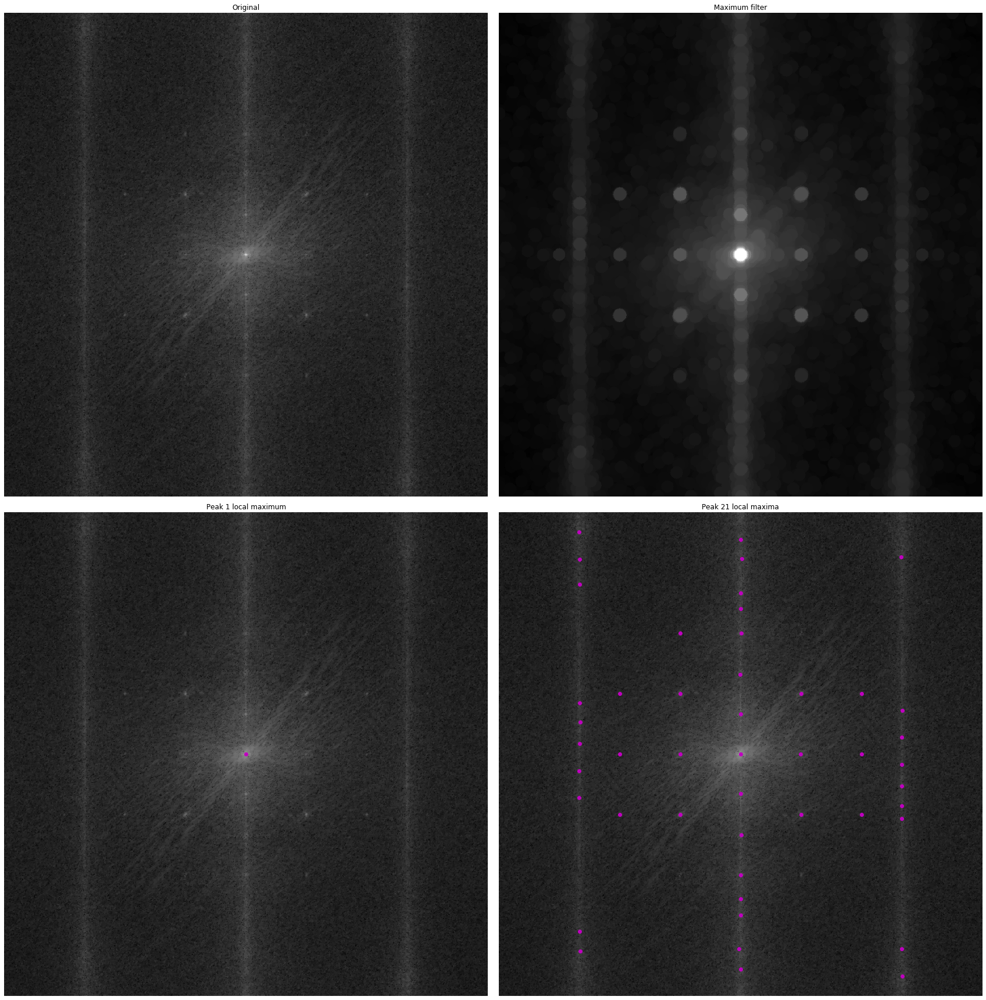

In [134]:
# display results
fig, axes = plt.subplots(2, 2, figsize=(24, 24), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(Ag, cmap='gray')
ax[0].axis('off')
ax[0].set_title('Original')

ax[1].imshow(image_max, cmap='gray')
ax[1].axis('off')
ax[1].set_title('Maximum filter')

ax[2].imshow(Ag, cmap='gray')
ax[2].autoscale(False)
ax[2].plot(coordinates_center[:, 1], coordinates_center[:, 0], 'mo')
ax[2].axis('off')
ax[2].set_title('Peak 1 local maximum')

ax[3].imshow(Ag, cmap='gray')
ax[3].autoscale(False)
ax[3].plot(coordinates[:, 1], coordinates[:, 0], 'mo')
ax[3].axis('off')
ax[3].set_title('Peak 21 local maxima')

fig.tight_layout()

plt.show()


In [135]:
fttt2_im = peak_local_max(Ag, min_distance=25, num_peaks=47)

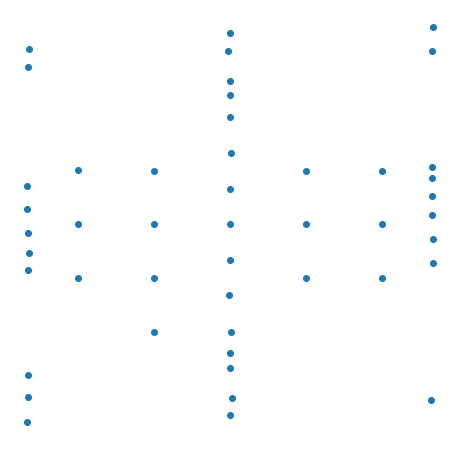

In [136]:
plt.figure(figsize =(8,8))
plt.axis('off')
plt.scatter(fttt2_im[:,1], fttt2_im[:,0]);

In [137]:
fttt2_im = peak_local_max(Ag, min_distance=25, num_peaks=47, indices = False)*1

(-0.5, 946.5, 946.5, -0.5)

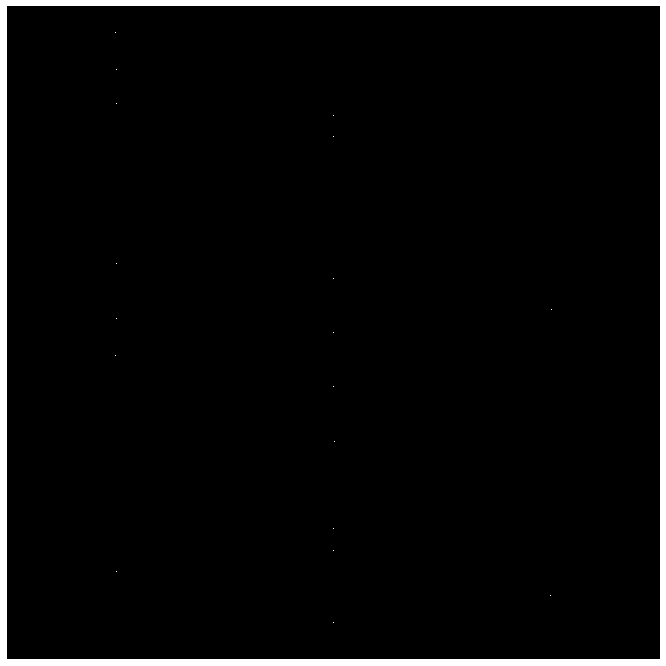

In [138]:
plt.figure(figsize=(12, 12))
plt.imshow(fttt2_im, cmap='gray', interpolation='None')
plt.autoscale(False)
plt.axis('off')

In [139]:
fttt2_im_center = peak_local_max(Ag, min_distance=10, num_peaks=1, indices = False)*1
fttt2_im_no_center = fttt2_im - fttt2_im_center 

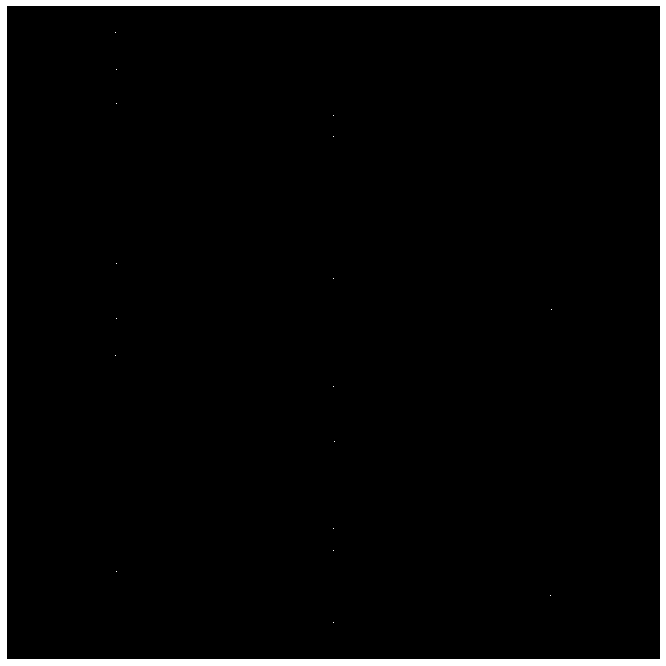

In [140]:
plt.figure(figsize=(12, 12))
plt.imshow(fttt2_im_no_center,  
           cmap='gray', interpolation = 'none'), plt.axis('off');

#### FOR VERTICAL LINES

In [141]:
stack_rows = np.sum(Ag, axis=0)

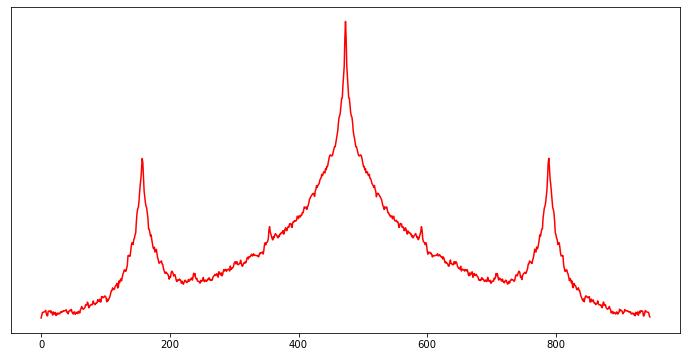

In [142]:
plt.figure(figsize=(12, 6))
plt.plot(stack_rows, 'r')
plt.yticks([])
plt.show()

In [143]:
multiplicity = 2 # number of expected peaks except for central

indexes, _ = signal.find_peaks(stack_rows, distance = len(stack_rows)/(2*multiplicity))
indexes = np.delete(indexes, len(indexes)//2)

In [144]:
test = np.zeros(np.shape(Ag))
rr, cc = ellipse(np.shape(Ag)[0]//2, indexes[0], 7, np.shape(Ag)[0]//2, rotation=np.deg2rad(90))
rr1, cc1 = ellipse(np.shape(Ag)[0]//2, indexes[-1], 7, np.shape(Ag)[0]//2, rotation=np.deg2rad(90))
test[rr, cc] = 1
test[rr1, cc1] = 1

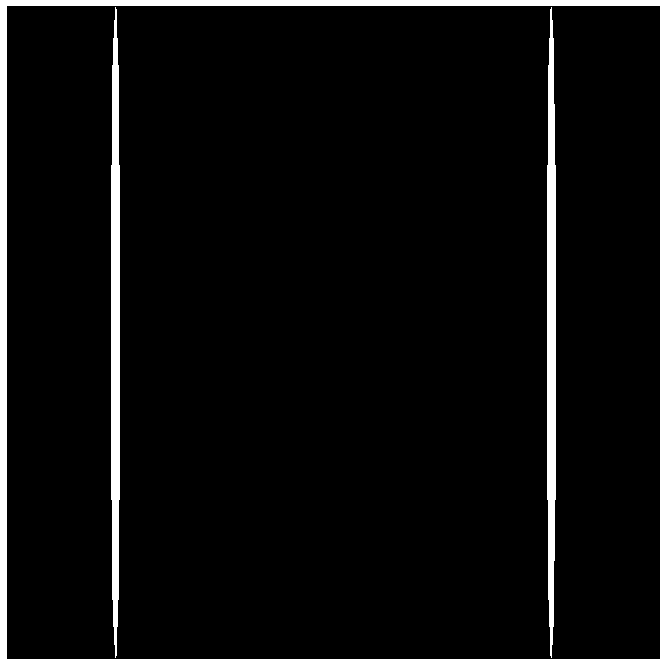

In [145]:
plt.figure(figsize=(12, 12))
plt.imshow(test,  
           cmap='gray', interpolation = 'none'), plt.axis('off');

#### Design footprint suppression filter by convolution with Gaussian disk 

Using `astropy`:
https://docs.astropy.org/en/stable/convolution/kernels.html

In [146]:
gauss_kernel = scipy_gaussian_2D(11)
filter00 = signal.fftconvolve(test, gauss_kernel,  mode='same')
filter00=normalise(filter00)

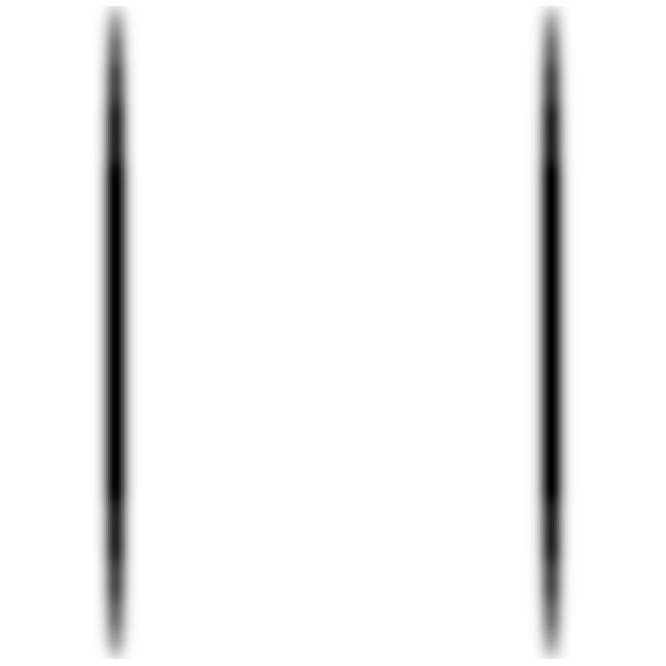

In [147]:
plt.figure(figsize=(12, 12))
plt.imshow(1-filter00, cmap='gray', interpolation = 'none'), plt.axis('off');

In [148]:
gauss_kernel1 = scipy_gaussian_2D(5)
filter1 = signal.fftconvolve(fttt2_im_no_center, gauss_kernel1, mode='same')
test, gauss_kernel
print (np.amin(filter1))
print (np.amax(filter1))

filter1=normalise(filter1)
print (np.amin(filter1))
print (np.amax(filter1))

-2.220446049250313e-18
0.006366197723675815
0.0
1.0


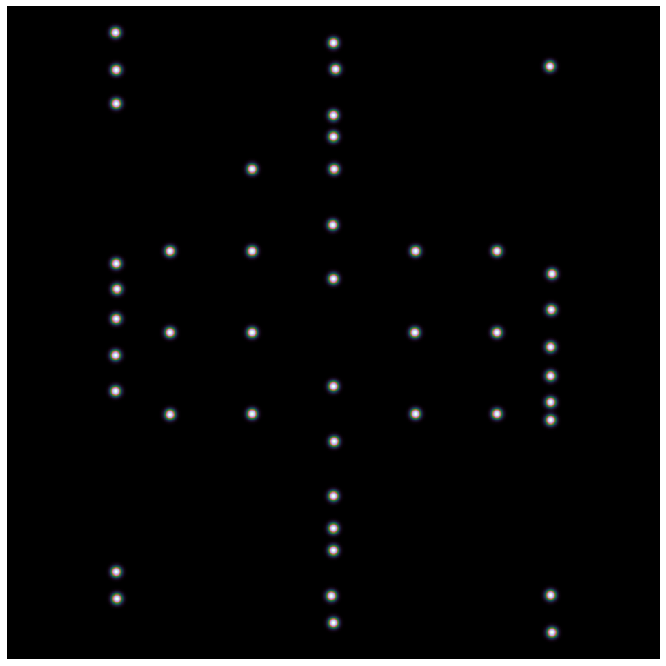

In [149]:
plt.figure(figsize=(12, 12))
plt.imshow(filter1, cmap='cubehelix', interpolation = 'none'), plt.axis('off');

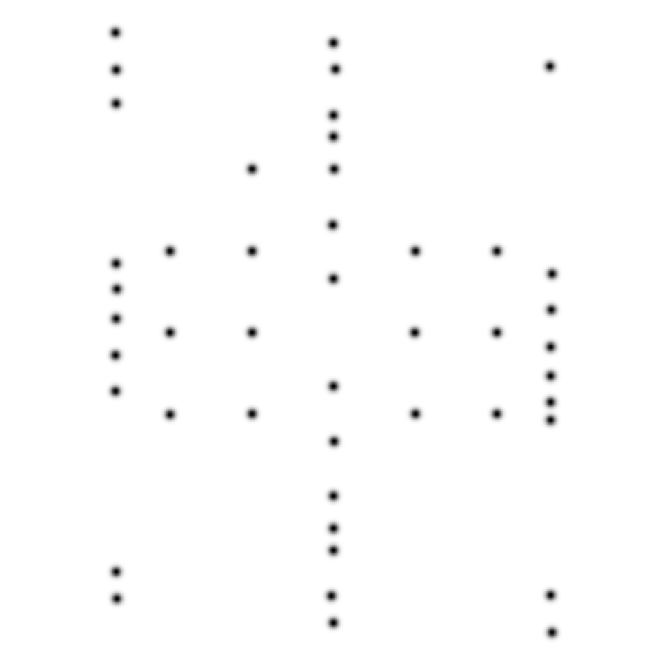

In [150]:
plt.figure(figsize=(12, 12))
plt.imshow(1-filter1, cmap='gray', interpolation = 'none'), plt.axis('off');

In [151]:
print (np.shape(test1))
print (np.shape(filter1))
print (np.shape(Ag))

(947, 947)
(947, 947)
(947, 947)


In [152]:
superfilter = (1-filter1)*(1-filter00)

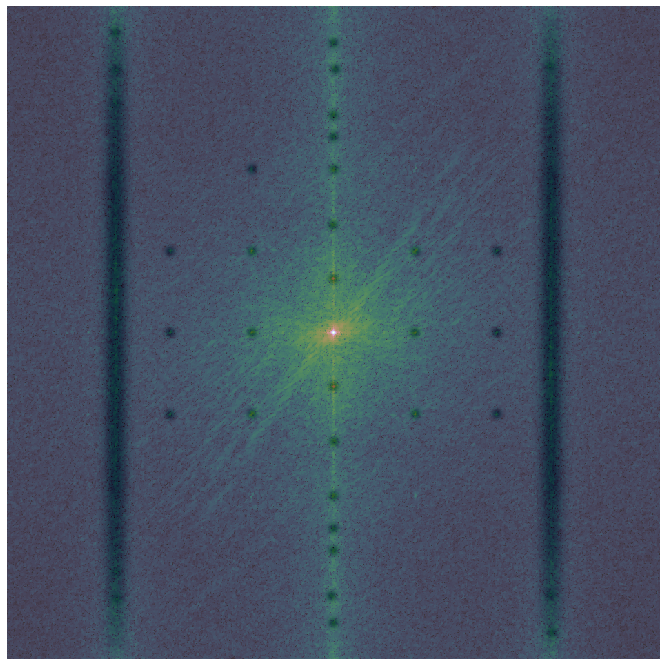

In [153]:
plt.figure(figsize=(12, 12))
plt.imshow(Ag, cmap='cubehelix', interpolation = 'none')
plt.imshow(superfilter, cmap='gray', interpolation = 'none', alpha=0.2), plt.axis('off');

##### Apply filter and view reconstructed image

In [154]:
filtered1 = ifft2(np.multiply(ifftshift(superfilter), fft2(test1.copy()))).real
print(np.shape(filtered1))
filtered1 = reverse_padding(horizon, filtered1, slc)
print(np.shape(filtered1))

(947, 947)
Unpadding image rows
(545, 947)


In [155]:
print(np.shape(horizon))

(545, 947)


In [156]:
compare_ssim(horizon, filtered1)

0.9891666185780454

In [157]:
diff = img_as_float(horizon - filtered1)

#### Custom exponential grayscale

In [158]:
# EXPONENTIAL FUNCTION
def expo(x,a,b):
    y = np.array(1-(np.exp(1-(a*x))/b))
    return 100.0*(y-min(y))/(max(y)-min(y)) 

In [159]:
import skimage.color as skl

In [160]:
x = np.linspace(0,255,256)
y1 = expo(x,0.007,2.5)
lexp256 = np.tile(y1, (256,1))
lexp256.shape

(256, 256)

In [161]:
lexp256 = np.tile(y1, (256,1))
lexp256.shape

(256, 256)

In [162]:
aexp256 = np.zeros((256,256))
bexp256 = np.zeros((256,256))
aexp256.shape

(256, 256)

In [163]:
lab_exp256 = np.array(list(zip(lexp256, aexp256, bexp256)))
lab_exp256.shape 

(256, 3, 256)

In [164]:
lab_exponential256 = np.swapaxes(lab_exp256,1,2)
lab_exponential256.shape

(256, 256, 3)

In [165]:
rgb_exponential256 = skl.lab2rgb(lab_exponential256)
rgb_exponential256.shape

(256, 256, 3)

In [166]:
l_exp = lab_exponential256[0,:,0]
r_exp = rgb_exponential256[0,:,0]
g_exp = rgb_exponential256[0,:,1]
b_exp = rgb_exponential256[0,:,2]

In [167]:
# sample 256 not perfectly 1. Normalizing y to [0-1]
normr_exp=(r_exp-min(r_exp))/(max(r_exp)-min(r_exp))
normg_exp=(g_exp-min(g_exp))/(max(g_exp)-min(g_exp))
normb_exp=(b_exp-min(b_exp))/(max(b_exp)-min(b_exp))

In [168]:
b3=normb_exp # value of blue at sample n
b2=normb_exp # value of blue at sample n
b1=np.linspace(0,1,len(b2)) # position of sample n - ranges from 0 to 1

g3=normg_exp 
g2=normg_exp
g1=np.linspace(0,1,len(g2))

r3=normr_exp 
r2=normr_exp
r1=np.linspace(0,1,len(r2))

# creating lists
r=zip(r1,r2,r3)
g=zip(g1,g2,g3)
b=zip(b1,b2,b3)

# transposing
rgb_=zip(r,g,b)
rgb=zip(*rgb_)
#print rgb

#creating dictionary
k=['red', 'green', 'blue'] 
exponential_gray=dict(zip(k,rgb)) # makes a dictionary from 2 lists

In [169]:
my_exp_cmap = clr.LinearSegmentedColormap('my_colormap', exponential_gray)

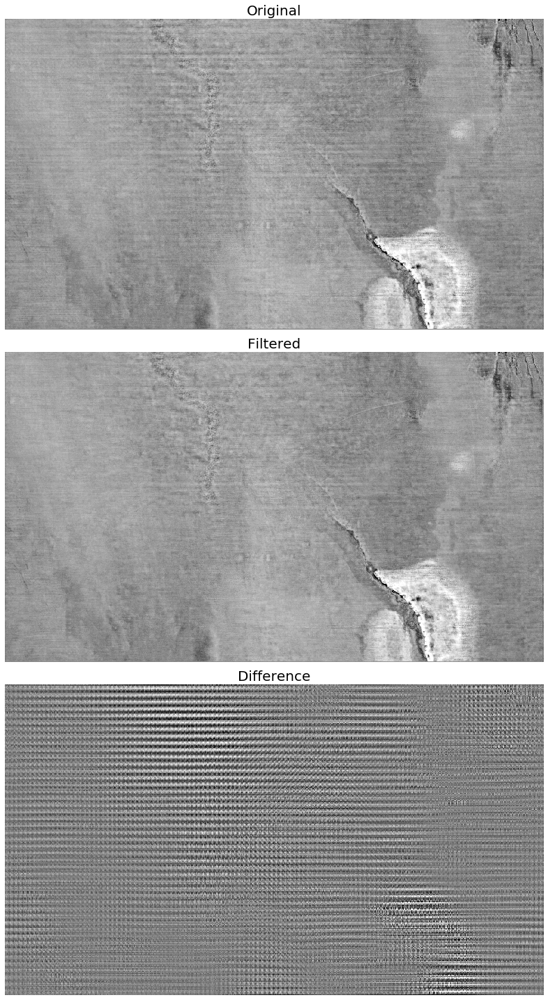

In [170]:
# display results
fig, axes = plt.subplots(3, 1, figsize=(24, 20), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(horizon, vmin = 0.25, vmax = 0.75, cmap=my_exp_cmap)
ax[0].axis('off')
ax[0].set_title('Original', fontsize=20)

ax[1].imshow(filtered1, vmin = 0.25, vmax = 0.75, cmap=my_exp_cmap)
ax[1].axis('off')
ax[1].set_title('Filtered', fontsize=20)

ax[2].imshow(diff,  vmin = np.amin(diff)/2, vmax = -np.amin(diff)/2, cmap='gray')
ax[2].axis('off')
ax[2].set_title('Difference', fontsize=20)

fig.tight_layout()

plt.show()

#### Moire pattern example

In [171]:
joints = normalise(rgb2gray(io.imread('moire_joints.png')))
print(np.shape(joints), np.amin(joints), np.amax(joints))

(750, 995) 0.0 1.0


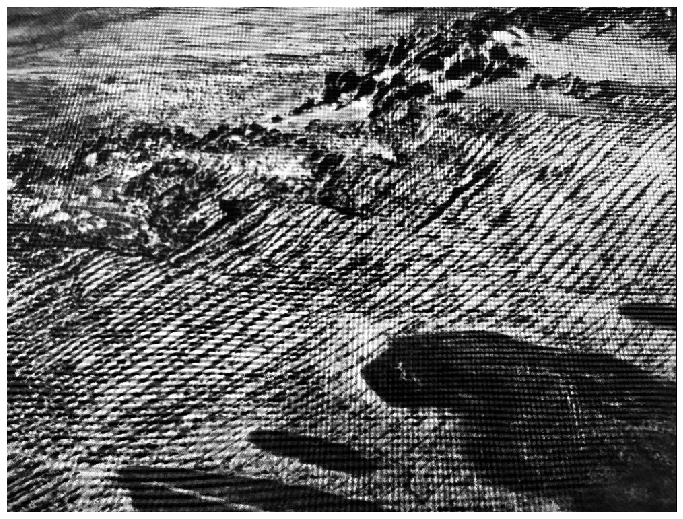

In [172]:
plt.figure(figsize=(12, 12))
plt.imshow(joints,  cmap='gray', interpolation = 'none'), plt.axis('off');

In [173]:
test1, slc = pad_next_square_size(joints)

Padded image rows


In [174]:
A, _ = numpy_fft2(raised_cosine(test1))

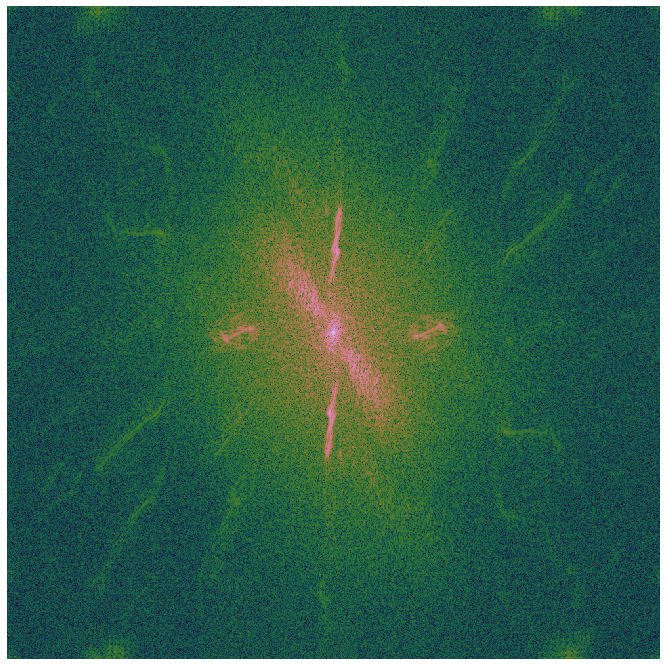

In [175]:
plt.figure(figsize=(12, 12))
plt.imshow(np.log(A +1),  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

In [176]:
Ag = denoise_tv_chambolle(np.log(A +1), weight=0.2)  

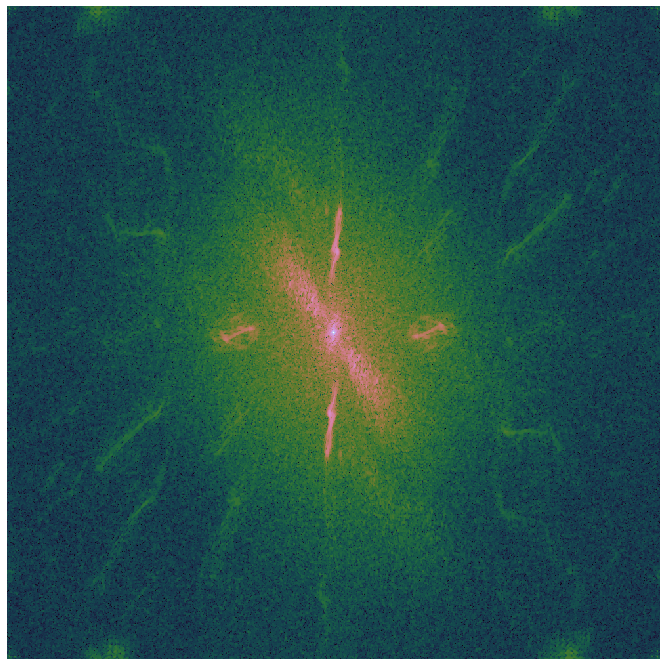

In [177]:
plt.figure(figsize=(12, 12))
plt.imshow(Ag,  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

In [178]:
fp = morph.disk(5)

In [179]:
image_max = ndi.maximum_filter(Ag, footprint = fp, mode='constant')
coordinates= peak_local_max(Ag, min_distance=20, num_peaks=3)
coordinates_center = peak_local_max(Ag, min_distance=10, num_peaks=1)

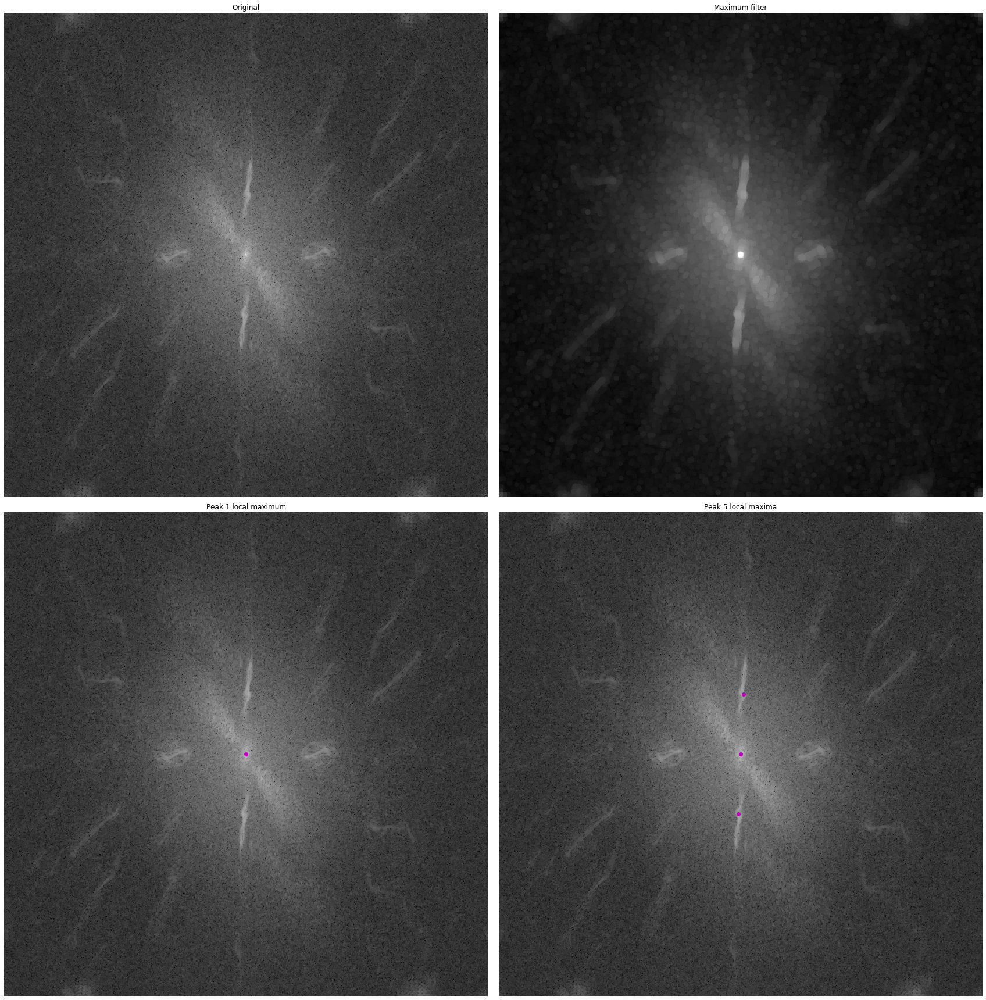

In [180]:
# display results
fig, axes = plt.subplots(2, 2, figsize=(24, 24), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(Ag, cmap='gray')
ax[0].axis('off')
ax[0].set_title('Original')

ax[1].imshow(image_max, cmap='gray')
ax[1].axis('off')
ax[1].set_title('Maximum filter')

ax[2].imshow(Ag, cmap='gray')
ax[2].autoscale(False)
ax[2].plot(coordinates_center[:, 1], coordinates_center[:, 0], 'mo')
ax[2].axis('off')
ax[2].set_title('Peak 1 local maximum')

ax[3].imshow(Ag, cmap='gray')
ax[3].autoscale(False)
ax[3].plot(coordinates[:, 1], coordinates[:, 0], 'mo')
ax[3].axis('off')
ax[3].set_title('Peak 5 local maxima')

fig.tight_layout()

plt.show()


In [181]:
fttt2_im = peak_local_max(Ag, min_distance=20, num_peaks=3, indices = False)*1

In [182]:
fttt2_im_center = peak_local_max(Ag, min_distance=20, num_peaks=1, indices = False)*1
fttt2_im_no_center = fttt2_im - fttt2_im_center 

In [183]:
gauss_kernel = scipy_gaussian_2D(7)
filter0 = signal.fftconvolve(fttt2_im_no_center, gauss_kernel, mode='same')

In [184]:
filtered1 = ifft2(np.multiply(ifftshift(1-filter0), fft2(test1.copy()))).real
print(np.shape(filtered1))

filtered1 = reverse_padding(joints, filtered1, slc)
print(np.shape(filtered1))

(995, 995)
Unpadding image rows
(750, 995)


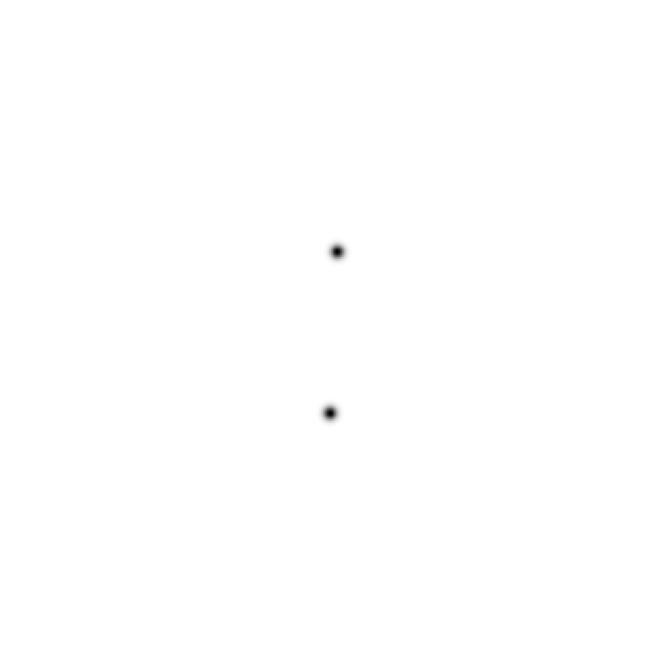

In [185]:
plt.figure(figsize=(12, 12))
plt.imshow(1-filter0, cmap='gray', interpolation = 'none'), plt.axis('off');

In [186]:
diff = img_as_float(joints - filtered1)

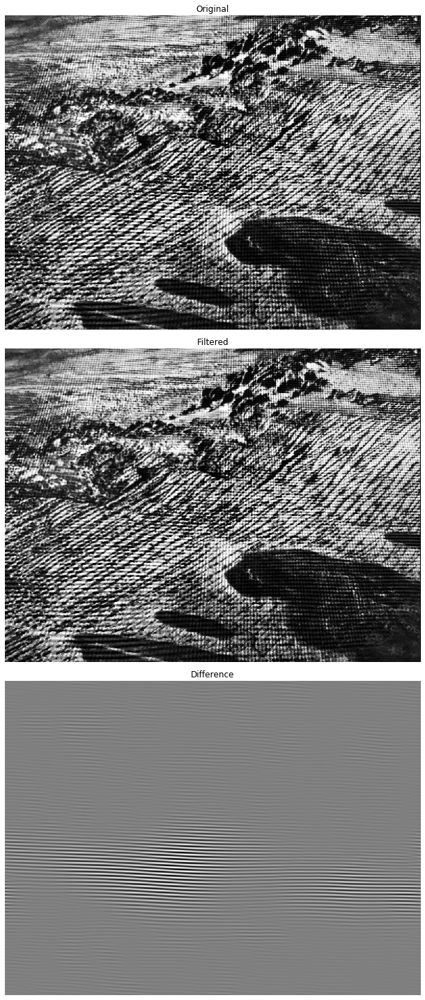

In [187]:
# display results
fig, axes = plt.subplots(3, 1, figsize=(26, 20), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(joints, cmap='gray')
ax[0].axis('off')
ax[0].set_title('Original')

ax[1].imshow(filtered1, cmap='gray')
ax[1].axis('off')
ax[1].set_title('Filtered')

ax[2].imshow(diff, cmap='gray')
ax[2].axis('off')
ax[2].set_title('Difference')

fig.tight_layout()

plt.show()


#### Ellipses

In [188]:
test1, slc = pad_next_square_size(joints)

Padded image rows


In [189]:
A, _ = numpy_fft2(raised_cosine(test1))

In [190]:
Ag = denoise_tv_chambolle(np.log(A +1), weight=0.2)  

In [191]:
fttt2_im = peak_local_max(Ag, min_distance=20, num_peaks=3, indices = False)*1

In [192]:
fttt2_im_center = peak_local_max(Ag, min_distance=20, num_peaks=1, indices = False)*1
fttt2_im_no_center = fttt2_im - fttt2_im_center 

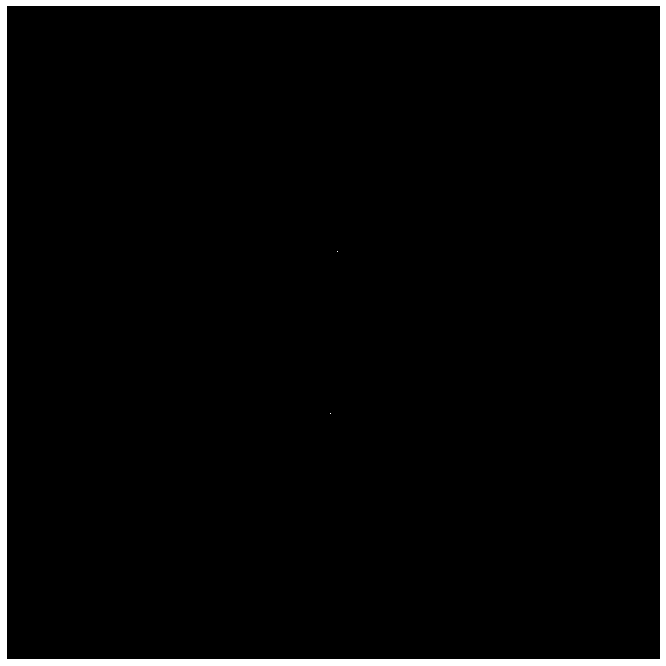

In [193]:
plt.figure(figsize=(12, 12))
plt.imshow(fttt2_im_no_center, cmap='gray', interpolation = 'none'), plt.axis('off');

In [194]:
test = np.zeros(np.shape(Ag), dtype=np.double)

# ellipses
dot = np.where(fttt2_im_no_center)
rr, cc = ellipse(dot[0][0], dot[1][0], 9, 71, rotation=np.deg2rad(85))
rr1, cc1 = ellipse(dot[0][1], dot[1][1], 9, 71, rotation=np.deg2rad(85))
test[rr, cc] = 1
test[rr1, cc1] = 1

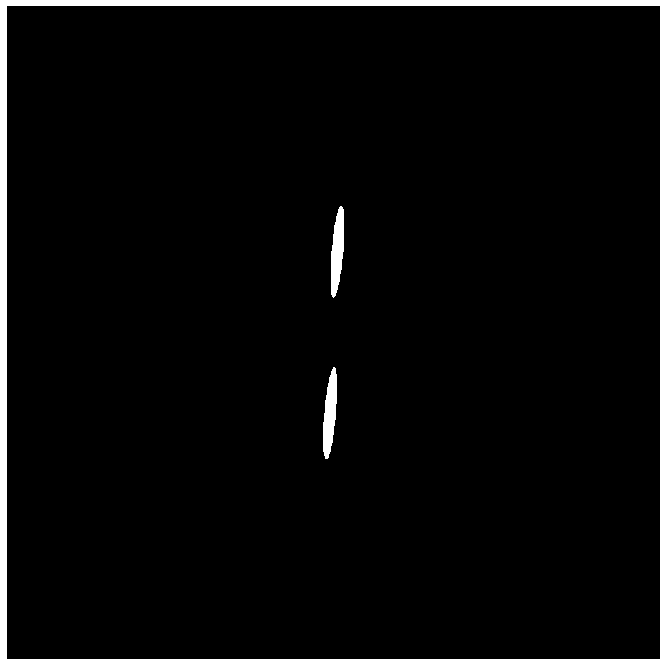

In [195]:
plt.figure(figsize=(12, 12))
plt.imshow(test, cmap='gray', interpolation = 'none'), plt.axis('off');

In [196]:
gauss_kernel = scipy_gaussian_2D(7)
filter0 = signal.fftconvolve(test, gauss_kernel, mode='same')

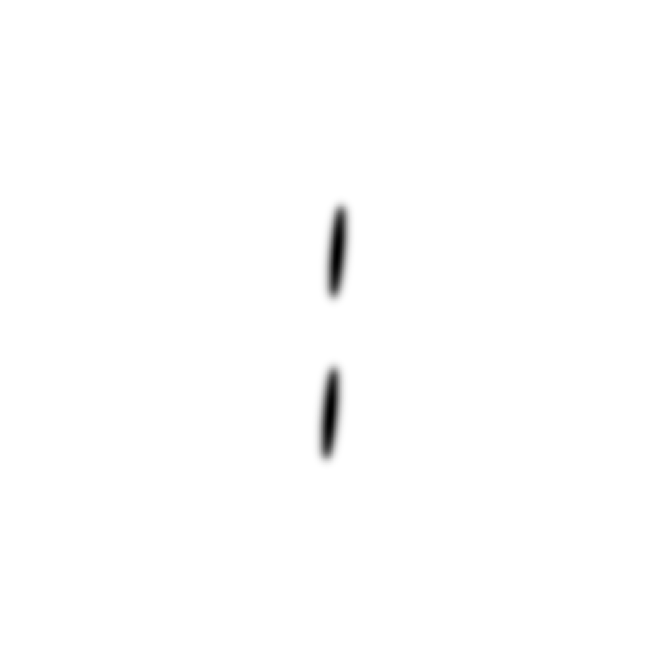

In [197]:
plt.figure(figsize=(12, 12))
plt.imshow(1-filter0, cmap='gray', interpolation = 'none'), plt.axis('off');

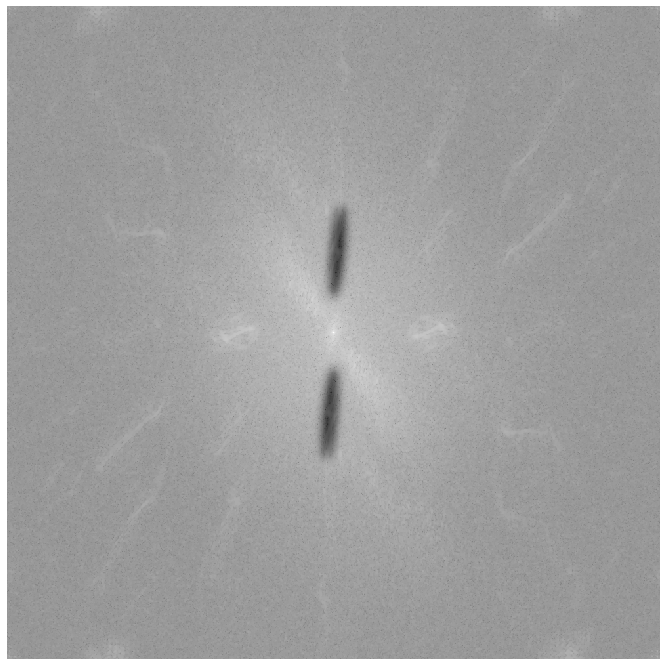

In [198]:
plt.figure(figsize=(12, 12))
plt.imshow(Ag, cmap='gray', interpolation = 'none')
plt.imshow(1-filter0, cmap='gray', interpolation = 'none', alpha=0.5), plt.axis('off');

In [199]:
filtered1 = ifft2(np.multiply(ifftshift(1-filter0), fft2(test1.copy()))).real
print(np.shape(filtered1))

filtered1 = reverse_padding(joints, filtered1, slc)
print(np.shape(filtered1))

(995, 995)
Unpadding image rows
(750, 995)


In [200]:
diff = img_as_float(joints - filtered1)

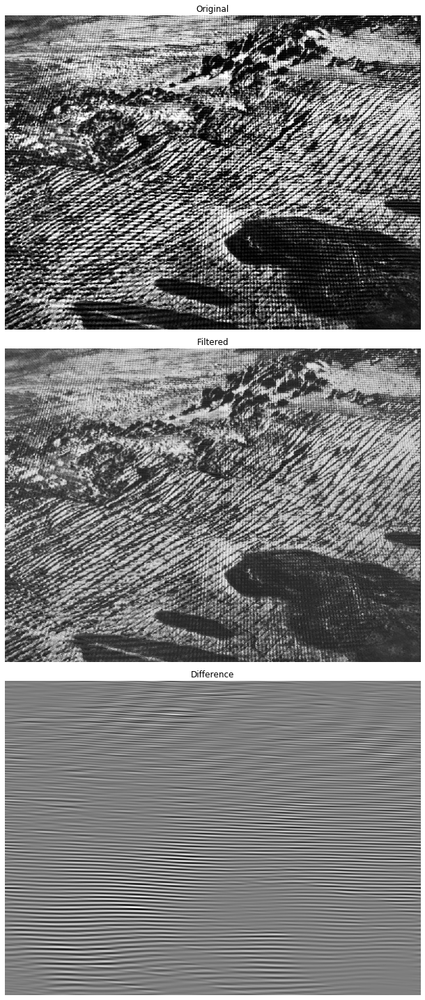

In [201]:
# display results
fig, axes = plt.subplots(3, 1, figsize=(26, 20), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(joints, cmap='gray')
ax[0].axis('off')
ax[0].set_title('Original')

ax[1].imshow(filtered1, cmap='gray')
ax[1].axis('off')
ax[1].set_title('Filtered')

ax[2].imshow(diff, cmap='gray')
ax[2].axis('off')
ax[2].set_title('Difference')

fig.tight_layout()

plt.show()


#### First ever newspaper photo printed using a halftone screen 

##### A Scene in Shantytown, March 1880

Source: http://www.sfu.ca/humanities-institute/contours/issue8/theory/5.html

Image file: http://www.sfu.ca/content/dam/sfu/humanities-institute/Images/contours/issue8/FIG%2010.2_A-SCENE-IN-SHANTYTOWN.jpg

History: https://en.wikipedia.org/wiki/The_Daily_Graphic#History

In [202]:
data = normalise(rgb2gray(io.imread('Scene_Shantytown_Horgan.jpg')))
print(np.shape(data), np.amin(data), np.amax(data))

(1294, 1997) 0.0 1.0


In [203]:
#data=data[50:-120, 50:-40]

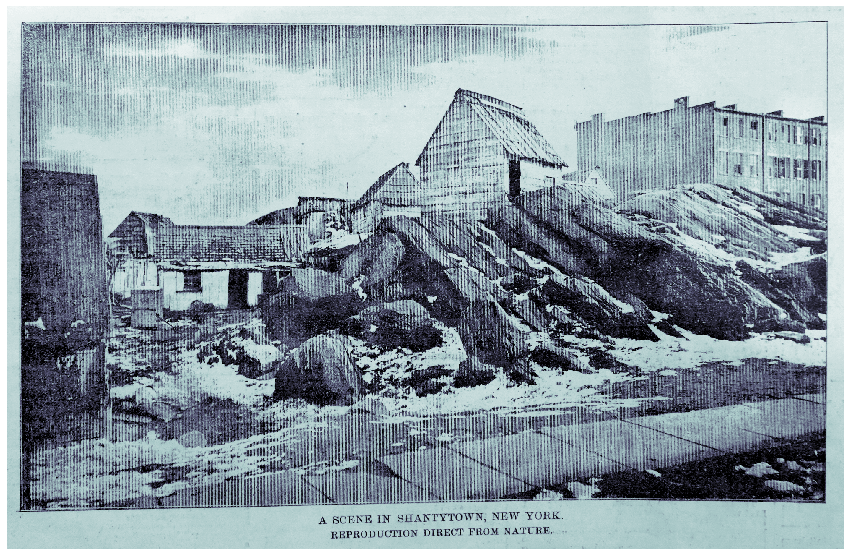

In [204]:
plt.figure(figsize=(15,12))
plt.imshow(data, cmap='bone'), plt.axis('off'); 

In [205]:
A, _ = numpy_fft2(data)

In [206]:
Ag = denoise_tv_chambolle(np.log(A +1), weight=0.2)  

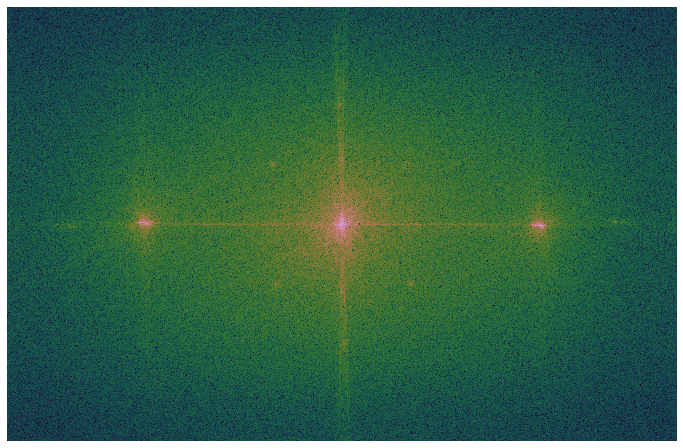

In [207]:
plt.figure(figsize=(12, 12))
plt.imshow(np.log(A +1),  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

In [208]:
sc = normalise(data)

In [209]:
test1, slc = pad_next_square_size(sc)

Padded image rows


In [210]:
A, _ = numpy_fft2(raised_cosine(test1))

In [211]:
Ag = denoise_tv_chambolle(np.log(A +1), weight=0.2)  

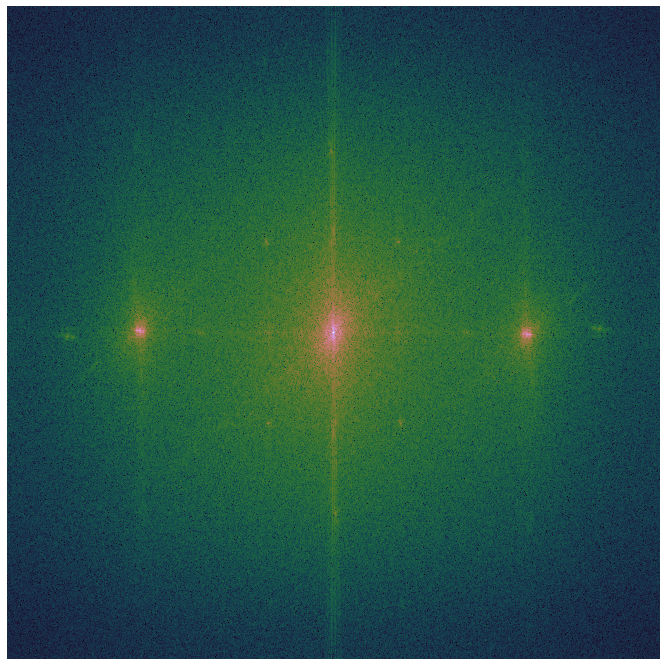

In [212]:
plt.figure(figsize=(12, 12))
plt.imshow(Ag,  cmap='cubehelix', interpolation = 'none'), plt.axis('off');

#### Trying stack

In [213]:
stack_rows = np.sum(Ag, axis=0)

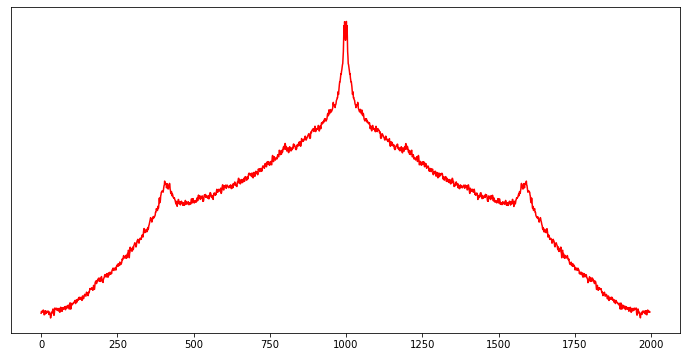

In [214]:
plt.figure(figsize=(12, 6))
plt.plot(stack_rows, 'r')
plt.yticks([])
plt.show()

In [215]:
multiplicity = 2 # number of expected peaks except for central

indexes, _ = signal.find_peaks(stack_rows, distance = len(stack_rows)/(2*multiplicity))
indexes = np.delete(indexes, len(indexes)//2)

In [216]:
test = np.zeros(np.shape(Ag))
rr, cc = ellipse(np.shape(Ag)[0]//2, indexes[0], 21, 21)
rr1, cc1 = ellipse(np.shape(Ag)[0]//2, indexes[-1], 21, 21)
test[rr, cc] = 1
test[rr1, cc1] = 1

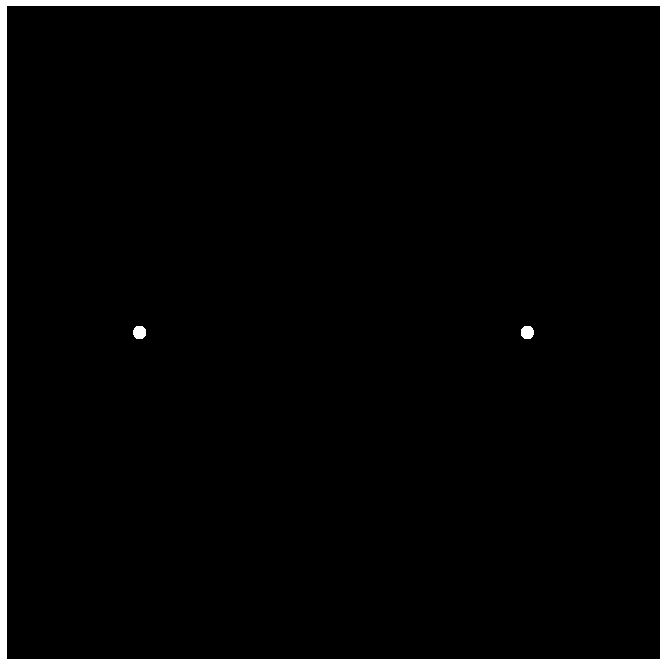

In [217]:
plt.figure(figsize=(12, 12))
plt.imshow(test,  
           cmap='gray', interpolation = 'none'), plt.axis('off');

In [218]:
gauss_kernel = scipy_gaussian_2D(15)
filter00 = signal.fftconvolve(test, gauss_kernel, mode='same')
filter00 = normalise(filter00)

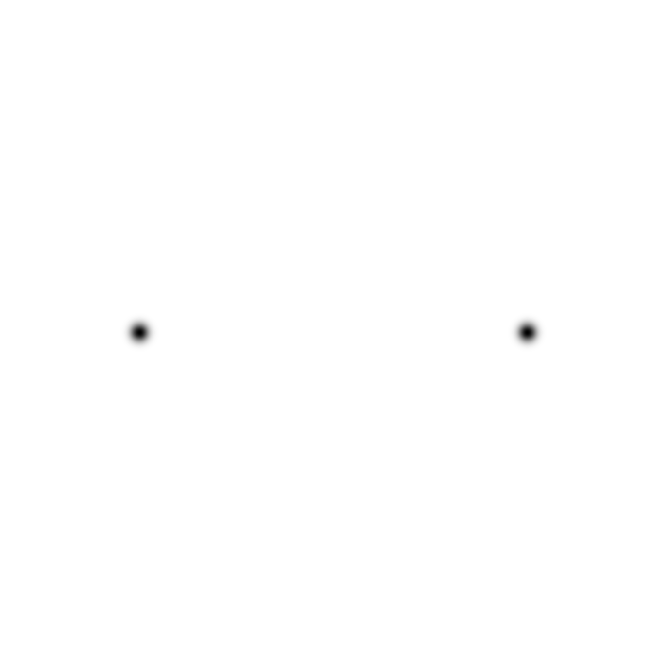

In [219]:
plt.figure(figsize=(12, 12))
plt.imshow(1-filter00, cmap='gray', interpolation = 'none'), plt.axis('off');

In [220]:
filtered1 = ifft2(np.multiply(ifftshift(1-filter00), fft2(test1.copy()))).real
print(np.shape(filtered1))

filtered1 = reverse_padding(sc, filtered1, slc)
print(np.shape(filtered1))

(1997, 1997)
Unpadding image rows
(1294, 1997)


In [221]:
compare_ssim(sc, filtered1)

0.8833779643262096

In [222]:
diff = img_as_float(sc - filtered1)

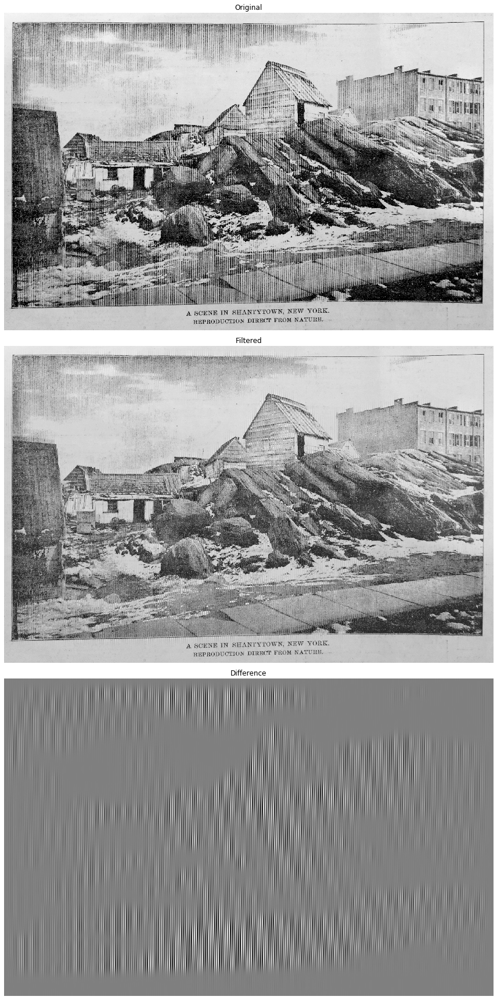

In [223]:
# display results
fig, axes = plt.subplots(3, 1, figsize=(16, 24), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(sc, cmap='gray')
ax[0].axis('off')
ax[0].set_title('Original')

ax[1].imshow(filtered1, cmap='gray')
ax[1].axis('off')
ax[1].set_title('Filtered')

ax[2].imshow(diff, cmap='gray')
ax[2].axis('off')
ax[2].set_title('Difference')

fig.tight_layout()
plt.show()